In [1]:
!gdown --id 1WFmPIGS5AceGMJRshzciS6jcwN8me4Ke

/usr/local/lib/python3.11/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1WFmPIGS5AceGMJRshzciS6jcwN8me4Ke
From (redirected): https://drive.google.com/uc?id=1WFmPIGS5AceGMJRshzciS6jcwN8me4Ke&confirm=t&uuid=091bf29e-5d8e-4425-b821-dbde67b92a8d
To: /content/images.zip
100% 1.40G/1.40G [00:23<00:00, 59.1MB/s]


In [2]:
!gdown --id 1y4R4T7UGJy-TXCJ4nqpHUE8L7j81HgkC

/usr/local/lib/python3.11/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1y4R4T7UGJy-TXCJ4nqpHUE8L7j81HgkC
To: /content/cytologia-data-1732098640162.csv
100% 1.82M/1.82M [00:00<00:00, 138MB/s]


In [3]:
import zipfile
with zipfile.ZipFile('/content/images.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/Images')

In [4]:
import os
import json
import pandas as pd
from tqdm import tqdm


In [5]:
# Paths
csv_path = '/content/cytologia-data-1732098640162.csv'
images_path = '/content/Images/dataset_cytologia'

df = pd.read_csv(csv_path)

print(df.head())


             NAME   x1   y1   x2   y2 class
0  cf7734a2-b.jpg   99   88  266  276   PNN
1  e6a3b579-0.jpg   92   78  272  284    MO
2  60f95776-f.jpg  110  103  251  251    MM
3  0894e581-c.jpg  112  121  248  262   LyB
4  3998a979-3.jpg   94   86  276  281    MO


In [6]:
df['class'].nunique()

23

In [7]:
df['class'].unique()

array(['PNN', 'MO', 'MM', 'LyB', 'LGL', 'Thromb', 'LLC', 'LAM3', 'EO',
       'LY', 'BA', 'MoB', 'LM', 'LH_lyAct', 'Lysee', 'Er', 'LF', 'LZMG',
       'MBL', 'SS', 'PM', 'B', 'M'], dtype=object)

In [8]:
df.shape

(52748, 6)

In [9]:
import pandas as pd
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical

## Quick Info

In [10]:
# Load CSV
df = pd.read_csv(csv_path)

# Display first few rows
print("First few rows of the dataframe:")
print(df.head())

# Display class distribution
print("\nClass distribution:")
print(df['class'].value_counts())

# Check for missing values
print("\nMissing values:")
print(df.isnull().sum())

# Check data types
print("\nData types:")
print(df.dtypes)

First few rows of the dataframe:
             NAME   x1   y1   x2   y2 class
0  cf7734a2-b.jpg   99   88  266  276   PNN
1  e6a3b579-0.jpg   92   78  272  284    MO
2  60f95776-f.jpg  110  103  251  251    MM
3  0894e581-c.jpg  112  121  248  262   LyB
4  3998a979-3.jpg   94   86  276  281    MO

Class distribution:
class
PNN         6827
Lysee       3408
LAM3        3338
LLC         3158
LyB         3029
MO          2743
MBL         2668
LGL         2439
EO          2432
Thromb      2319
Er          2308
B           2263
LF          2131
LY          2092
M           1994
MM          1707
LH_lyAct    1705
MoB         1531
PM          1152
BA          1001
LM           944
LZMG         845
SS           714
Name: count, dtype: int64

Missing values:
NAME     0
x1       0
y1       0
x2       0
y2       0
class    0
dtype: int64

Data types:
NAME     object
x1        int64
y1        int64
x2        int64
y2        int64
class    object
dtype: object


## Initial Sample visualization

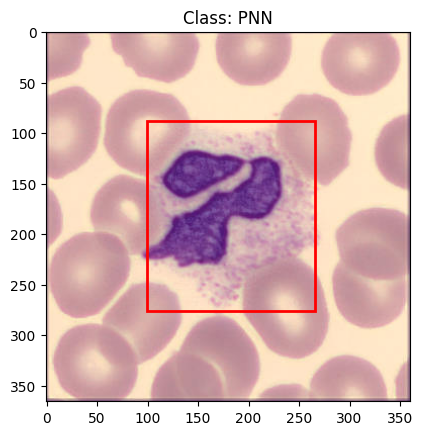

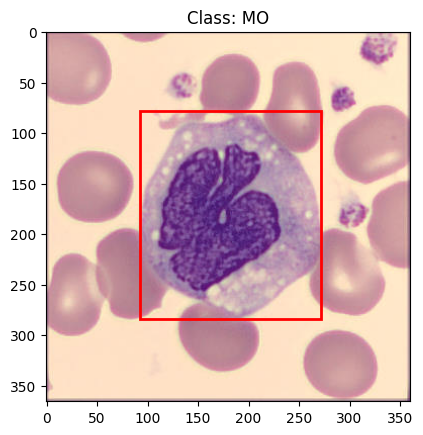

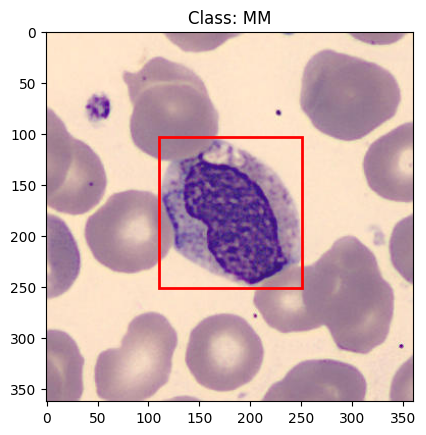

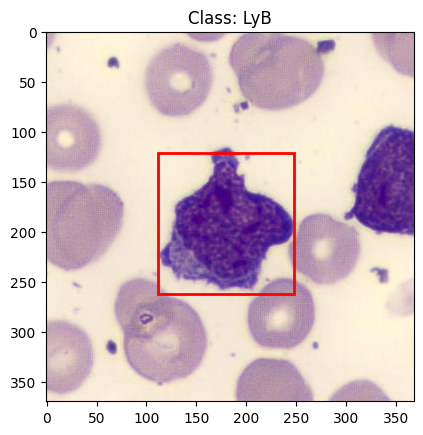

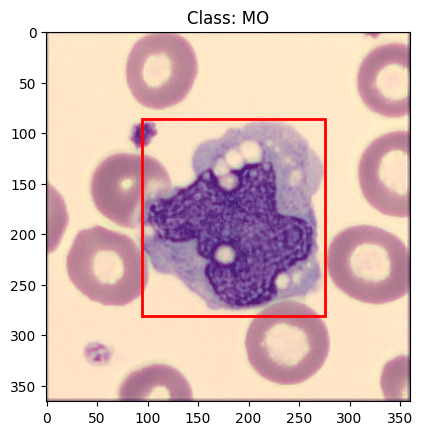

In [11]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

# Function to display image with bounding boxes
def display_image_with_boxes(df, images_path, index=0):
    row = df.iloc[index]
    image_path = f"{images_path}/{row['NAME']}"
    image = Image.open(image_path)
    fig, ax = plt.subplots(1)
    ax.imshow(image)
    # Create a Rectangle patch
    rect = patches.Rectangle((row['x1'], row['y1']), row['x2'] - row['x1'], row['y2'] - row['y1'],
                             linewidth=2, edgecolor='r', facecolor='none')
    # Add the patch to the Axes
    ax.add_patch(rect)
    plt.title(f"Class: {row['class']}")
    plt.show()

# Display the first 5 images with bounding boxes
for i in range(5):
    display_image_with_boxes(df, images_path, index=i)


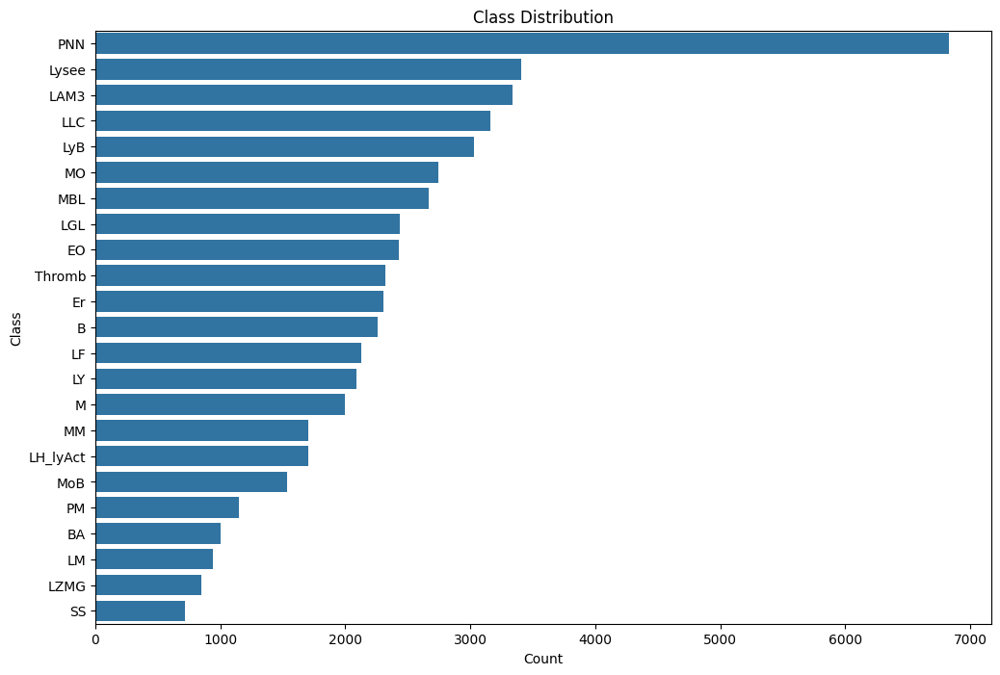

In [12]:
import seaborn as sns

plt.figure(figsize=(12, 8))
sns.countplot(y='class', data=df, order=df['class'].value_counts().index)
plt.title('Class Distribution')
plt.xlabel('Count')
plt.ylabel('Class')
plt.show()


### Duplicates

In [13]:
# Check for exact duplicate rows
exact_duplicates = df[df.duplicated()]
print(f"Number of exact duplicate rows: {exact_duplicates.shape[0]}")

if not exact_duplicates.empty:
    print("Exact duplicate rows found:")
    print(exact_duplicates.head())
else:
    print("No exact duplicate rows found.")


Number of exact duplicate rows: 0
No exact duplicate rows found.


In [14]:
# Check for duplicate bounding boxes within the same image
bbox_duplicates = df[df.duplicated(subset=['NAME', 'x1', 'y1', 'x2', 'y2', 'class'], keep=False)]
print(f"Number of duplicate bounding box entries: {bbox_duplicates.shape[0]}")

if not bbox_duplicates.empty:
    print("Duplicate bounding box entries found:")
    print(bbox_duplicates.head())
else:
    print("No duplicate bounding box entries found.")


Number of duplicate bounding box entries: 0
No duplicate bounding box entries found.


In [15]:
# Group by 'NAME', 'x1', 'y1', 'x2', 'y2'
duplicate_bboxes = (
    df.groupby(['NAME', 'x1', 'y1', 'x2', 'y2'])['class']
    .nunique()
    .reset_index()
)

# Filter groups with more than one unique class
duplicates_with_different_classes = duplicate_bboxes[duplicate_bboxes['class'] > 1]

# Merge back to the original dataframe to display the conflicting rows
conflicting_rows = pd.merge(
    df,
    duplicates_with_different_classes[['NAME', 'x1', 'y1', 'x2', 'y2']],
    on=['NAME', 'x1', 'y1', 'x2', 'y2']
)

print(f"Number of bounding boxes with multiple classes: {duplicates_with_different_classes.shape[0]}")
print("Sample conflicting rows:")
print(conflicting_rows.head())


Number of bounding boxes with multiple classes: 0
Sample conflicting rows:
Empty DataFrame
Columns: [NAME, x1, y1, x2, y2, class]
Index: []


# Number of bounding boxes inside other boxes with the same class

In [16]:
import pandas as pd
import itertools

# Function to check if box A is inside box B
def is_contained(box_a, box_b):
    return (
        box_a['x1'] >= box_b['x1'] and
        box_a['y1'] >= box_b['y1'] and
        box_a['x2'] <= box_b['x2'] and
        box_a['y2'] <= box_b['y2']
    )

# Initialize a list to store contained bounding boxes
contained_boxes_same_class = []

# Group the DataFrame by image name
grouped = df.groupby('NAME')

# Iterate through each group (each image)
for image_name, group in grouped:
    # If there's only one bounding box in the image, skip
    if len(group) < 2:
        continue

    # Iterate through all unique pairs of bounding boxes
    for (idx_a, box_a), (idx_b, box_b) in itertools.combinations(group.iterrows(), 2):
        # Check if box A is inside box B and has the same class
        if is_contained(box_a, box_b) and box_a['class'] == box_b['class']:
            contained_boxes_same_class.append({
                'Image': image_name,
                'Contained_Box_Index': idx_a,
                'Contained_Box_Coordinates': (box_a['x1'], box_a['y1'], box_a['x2'], box_a['y2']),
                'Container_Box_Index': idx_b,
                'Container_Box_Coordinates': (box_b['x1'], box_b['y1'], box_b['x2'], box_b['y2']),
                'Class': box_a['class']
            })
        # Check if box B is inside box A and has the same class
        elif is_contained(box_b, box_a) and box_b['class'] == box_a['class']:
            contained_boxes_same_class.append({
                'Image': image_name,
                'Contained_Box_Index': idx_b,
                'Contained_Box_Coordinates': (box_b['x1'], box_b['y1'], box_b['x2'], box_b['y2']),
                'Container_Box_Index': idx_a,
                'Container_Box_Coordinates': (box_a['x1'], box_a['y1'], box_a['x2'], box_a['y2']),
                'Class': box_b['class']
            })

# Convert the results to a DataFrame
contained_df_same_class = pd.DataFrame(contained_boxes_same_class)

# Display results
print(f"Number of bounding boxes inside other boxes with the same class: {contained_df_same_class.shape[0]}")
if not contained_df_same_class.empty:
    print("Sample contained boxes:")
    print(contained_df_same_class.head())


Number of bounding boxes inside other boxes with the same class: 3
Sample contained boxes:
            Image  Contained_Box_Index Contained_Box_Coordinates  \
0  069bced3-7.jpg                40268      (304, 187, 359, 281)   
1  735f9a9c-0.jpg                17317       (91, 151, 252, 284)   
2  f0cac2a6-1.jpg                 3810      (117, 181, 287, 348)   

   Container_Box_Index Container_Box_Coordinates Class  
0                37499       (267, 64, 360, 288)   LLC  
1                17639         (68, 2, 263, 296)    EO  
2                24795         (55, 8, 379, 348)   MoB  


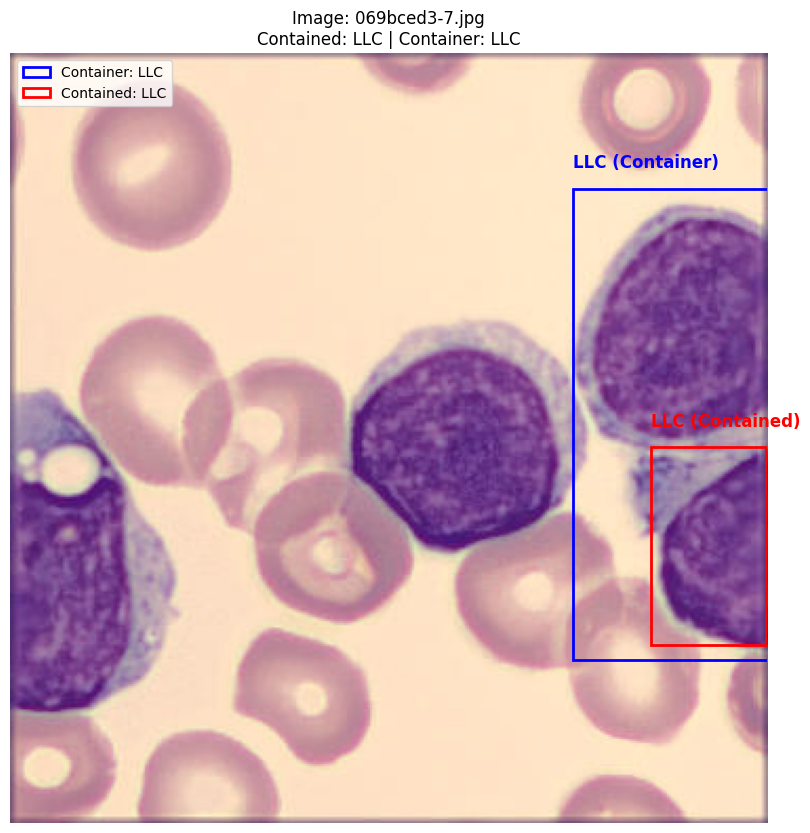

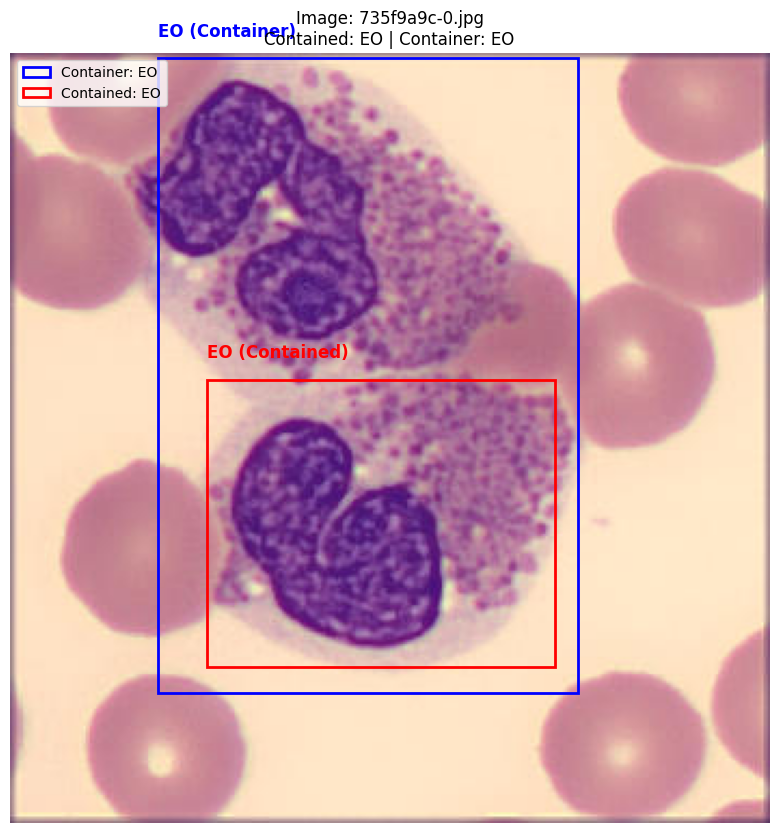

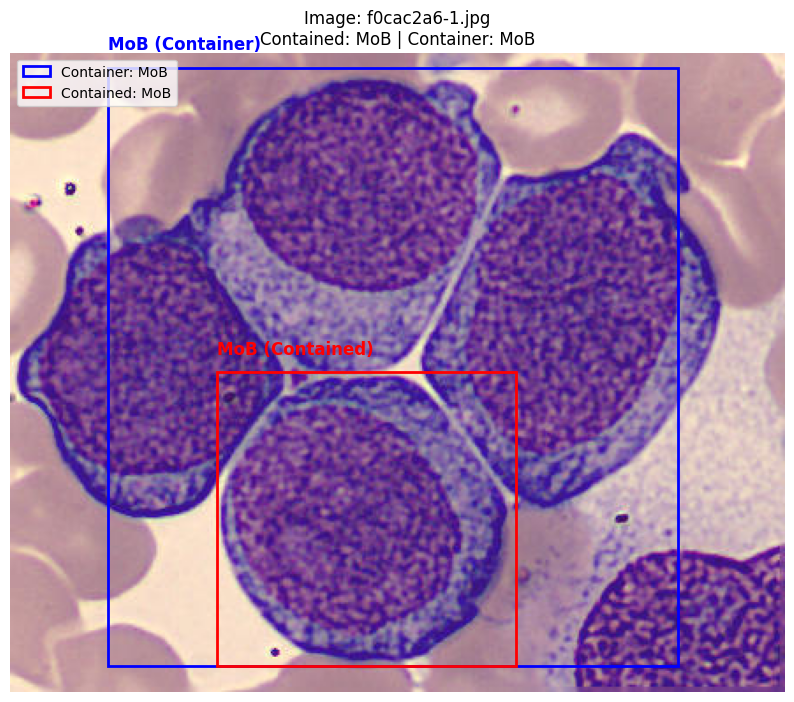

In [17]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

def visualize_contained_boxes_same_class(contained_df_same_class, df, images_path, num_samples=5):
    """
    Visualize bounding boxes that are contained within other bounding boxes with the same class.

    Parameters:
    - contained_df_same_class: DataFrame with contained bounding boxes.
    - df: Original DataFrame with bounding box data.
    - images_path: Path to the directory containing images.
    - num_samples: Number of samples to visualize.
    """
    # Randomly select a subset of contained bounding boxes to visualize
    samples = contained_df_same_class.sample(n=min(num_samples, len(contained_df_same_class)), random_state=42)

    for _, row in samples.iterrows():
        image_name = row['Image']
        contained_idx = row['Contained_Box_Index']
        container_idx = row['Container_Box_Index']

        # Retrieve bounding box details
        contained_box = df.loc[contained_idx]
        container_box = df.loc[container_idx]

        # Load the image
        image_path = f"{images_path}/{image_name}"
        try:
            image = Image.open(image_path)
        except FileNotFoundError:
            print(f"Image not found: {image_path}")
            continue

        fig, ax = plt.subplots(1, figsize=(10, 10))
        ax.imshow(image)

        # Draw the container bounding box in blue
        rect_container = patches.Rectangle(
            (container_box['x1'], container_box['y1']),
            container_box['x2'] - container_box['x1'],
            container_box['y2'] - container_box['y1'],
            linewidth=2,
            edgecolor='blue',
            facecolor='none',
            label=f"Container: {container_box['class']}"
        )
        ax.add_patch(rect_container)

        # Draw the contained bounding box in red
        rect_contained = patches.Rectangle(
            (contained_box['x1'], contained_box['y1']),
            contained_box['x2'] - contained_box['x1'],
            contained_box['y2'] - contained_box['y1'],
            linewidth=2,
            edgecolor='red',
            facecolor='none',
            label=f"Contained: {contained_box['class']}"
        )
        ax.add_patch(rect_contained)

        # Annotate class labels
        ax.text(
            container_box['x1'], container_box['y1'] - 10,
            f"{container_box['class']} (Container)",
            color='blue', fontsize=12, fontweight='bold'
        )
        ax.text(
            contained_box['x1'], contained_box['y1'] - 10,
            f"{contained_box['class']} (Contained)",
            color='red', fontsize=12, fontweight='bold'
        )

        # Add legend
        plt.legend(loc="upper left")
        plt.title(f"Image: {image_name}\nContained: {contained_box['class']} | Container: {container_box['class']}")
        plt.axis('off')
        plt.show()

# Visualize up to 5 contained bounding boxes
if contained_df_same_class.empty:
    print("No contained bounding boxes with the same class to visualize.")
else:
    visualize_contained_boxes_same_class(contained_df_same_class, df, images_path, num_samples=5)


### Same bounding box different class

In [18]:
import pandas as pd
import itertools

# Function to check if two boxes have identical coordinates
def is_identical(box_a, box_b):
    return (
        box_a['x1'] == box_b['x1'] and
        box_a['y1'] == box_b['y1'] and
        box_a['x2'] == box_b['x2'] and
        box_a['y2'] == box_b['y2']
    )

# Initialize a list to store boxes with identical coordinates but different classes
identical_diff_class_boxes = []

# Group the DataFrame by image name
grouped = df.groupby('NAME')

# Iterate through each group (each image)
for image_name, group in grouped:
    # If there's only one bounding box in the image, skip
    if len(group) < 2:
        continue

    # Iterate through all unique pairs of bounding boxes
    for (idx_a, box_a), (idx_b, box_b) in itertools.combinations(group.iterrows(), 2):
        if is_identical(box_a, box_b):
            if box_a['class'] != box_b['class']:
                identical_diff_class_boxes.append({
                    'Image': image_name,
                    'Box_A_Index': idx_a,
                    'Box_A_Coordinates': (box_a['x1'], box_a['y1'], box_a['x2'], box_a['y2']),
                    'Box_A_Class': box_a['class'],
                    'Box_B_Index': idx_b,
                    'Box_B_Coordinates': (box_b['x1'], box_b['y1'], box_b['x2'], box_b['y2']),
                    'Box_B_Class': box_b['class']
                })

# Convert the results to a DataFrame
identical_diff_class_df = pd.DataFrame(identical_diff_class_boxes)

# Display results
print(f"Number of bounding boxes with identical coordinates but different classes: {identical_diff_class_df.shape[0]}")
if not identical_diff_class_df.empty:
    print("\nSample identical boxes with different classes:")
    print(identical_diff_class_df.head())


Number of bounding boxes with identical coordinates but different classes: 0


# Number of overlapping bounding box pairs

In [19]:
import pandas as pd
import itertools

# Function to calculate Intersection over Union (IoU)
def calculate_iou(box_a, box_b):
    # Check for invalid boxes
    if box_a['x2'] <= box_a['x1'] or box_a['y2'] <= box_a['y1']:
        return 0
    if box_b['x2'] <= box_b['x1'] or box_b['y2'] <= box_b['y1']:
        return 0

    # Coordinates of the intersection rectangle
    x1 = max(box_a['x1'], box_b['x1'])
    y1 = max(box_a['y1'], box_b['y1'])
    x2 = min(box_a['x2'], box_b['x2'])
    y2 = min(box_a['y2'], box_b['y2'])

    # Calculate intersection area
    intersection_area = max(0, x2 - x1) * max(0, y2 - y1)

    # Calculate areas of each box
    area_a = (box_a['x2'] - box_a['x1']) * (box_a['y2'] - box_a['y1'])
    area_b = (box_b['x2'] - box_b['x1']) * (box_b['y2'] - box_b['y1'])

    # Calculate union area
    union_area = area_a + area_b - intersection_area

    # Calculate IoU
    iou = intersection_area / union_area if union_area > 0 else 0
    return iou

# Ensure the DataFrame has required columns
required_columns = {'NAME', 'x1', 'y1', 'x2', 'y2'}
if not required_columns.issubset(df.columns):
    raise ValueError(f"DataFrame is missing one or more required columns: {required_columns - set(df.columns)}")

# Initialize a counter for overlapping boxes and a list to store overlap details
overlap_count = 0
overlaps = []

# Group the DataFrame by image name
grouped = df.groupby('NAME')

# Threshold for overlap (IoU > 0 means any overlap)
iou_threshold = 0.0

# Iterate through each group (each image)
for image_name, group in grouped:
    if len(group) < 2:
        continue  # Skip images with fewer than 2 bounding boxes

    # Iterate through all unique pairs of bounding boxes
    for (idx_a, box_a), (idx_b, box_b) in itertools.combinations(group.iterrows(), 2):
        iou = calculate_iou(box_a, box_b)
        if iou > iou_threshold:
            overlap_count += 1
            overlaps.append((image_name, idx_a, idx_b, iou))

print(f"Number of overlapping bounding box pairs: {overlap_count}")

# Display sample overlap details
if overlaps:
    print("Sample overlaps:")
    for sample in overlaps[:5]:  # Show the first 5 overlaps
        print(f"Image: {sample[0]}, Box A Index: {sample[1]}, Box B Index: {sample[2]}, IoU: {sample[3]:.2f}")


Number of overlapping bounding box pairs: 2691
Sample overlaps:
Image: 005295fa-e.jpg, Box A Index: 5272, Box B Index: 13789, IoU: 0.01
Image: 007079b5-e.jpg, Box A Index: 27291, Box B Index: 35056, IoU: 0.06
Image: 007079b5-e.jpg, Box A Index: 27291, Box B Index: 40705, IoU: 0.04
Image: 007079b5-e.jpg, Box A Index: 40705, Box B Index: 46503, IoU: 0.00
Image: 00947c65-8.jpg, Box A Index: 9521, Box B Index: 11180, IoU: 0.06


Total overlapping pairs: 2691


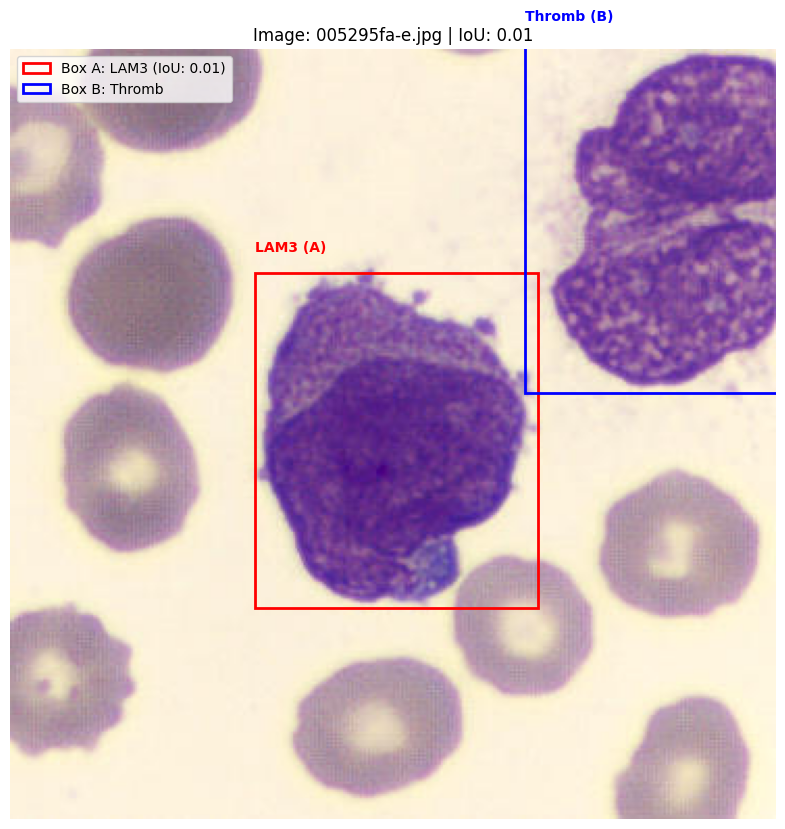

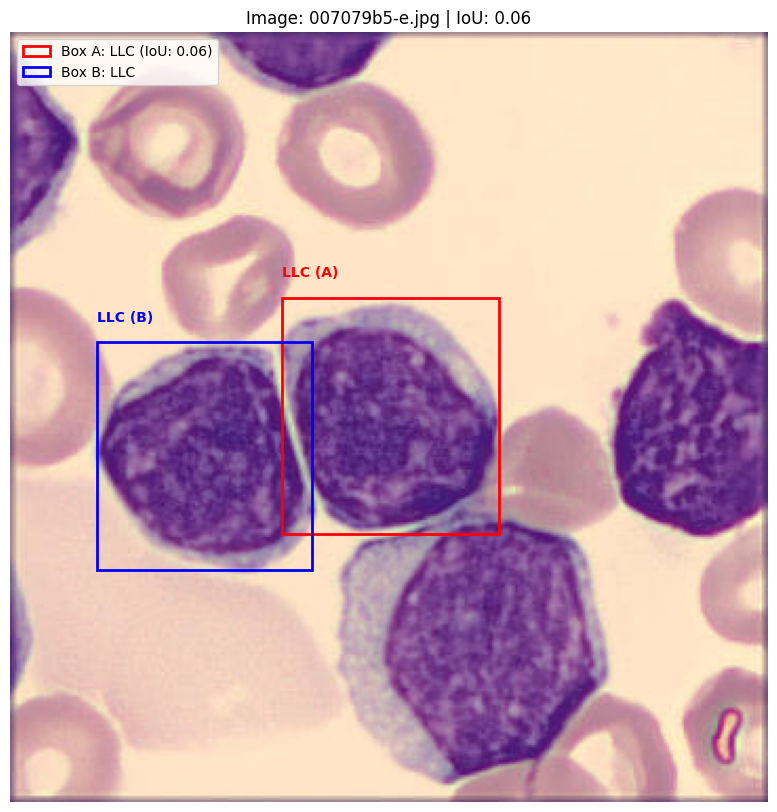

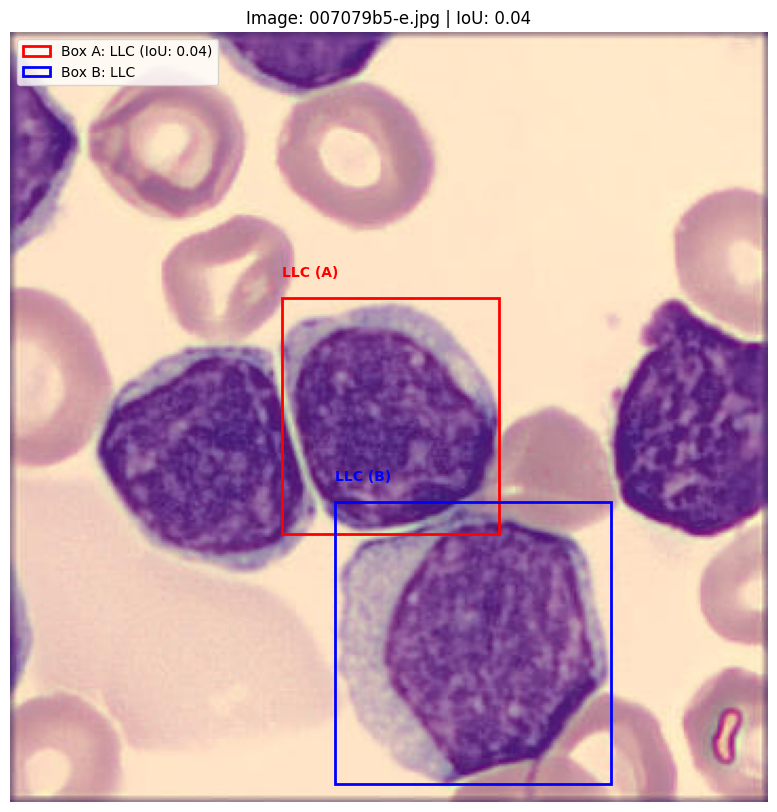

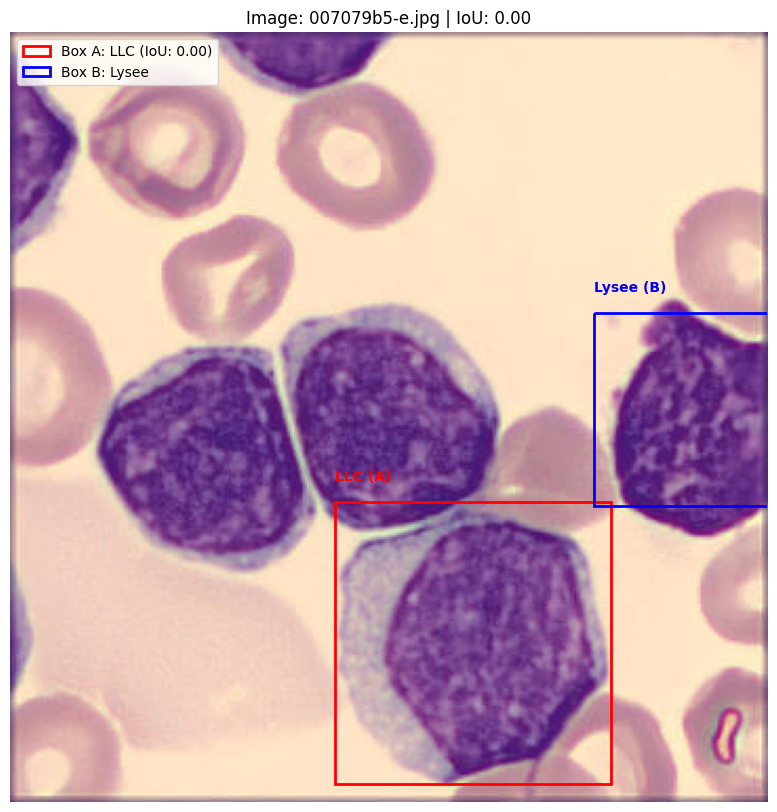

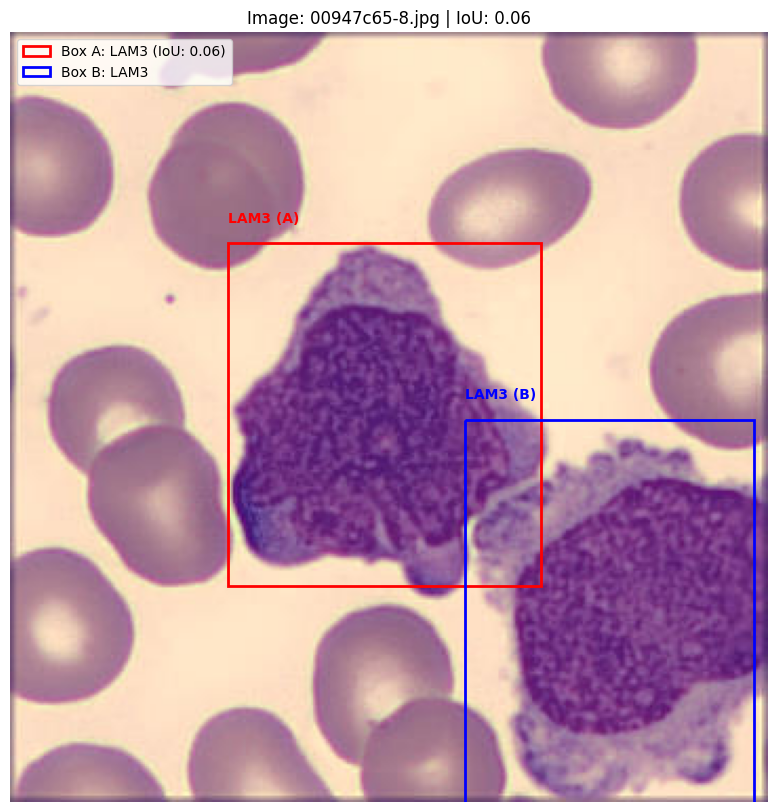

In [20]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

def debug_visualization_from_overlaps(overlaps, df, images_path, num_samples=5):
    """
    Visualize overlapping bounding boxes using precomputed overlaps, including class labels.

    Parameters:
    - overlaps: List of precomputed overlaps (image_name, box_a_index, box_b_index, iou).
    - df: Original DataFrame containing bounding box data.
    - images_path: Path to the directory containing images.
    - num_samples: Number of overlaps to visualize.
    """
    if not overlaps:
        print("No overlapping boxes found.")
        return

    print(f"Total overlapping pairs: {len(overlaps)}")

    # Visualize up to num_samples overlaps
    for sample in overlaps[:num_samples]:
        image_name, idx_a, idx_b, iou = sample
        image_path = f"{images_path}/{image_name}"

        try:
            # Load the image
            image = Image.open(image_path)
        except FileNotFoundError:
            print(f"Image not found: {image_path}")
            continue

        # Retrieve the bounding boxes
        box_a = df.iloc[idx_a]
        box_b = df.iloc[idx_b]

        fig, ax = plt.subplots(1, figsize=(10, 10))
        ax.imshow(image)

        # Draw bounding box A
        rect_a = patches.Rectangle(
            (box_a['x1'], box_a['y1']),
            box_a['x2'] - box_a['x1'],
            box_a['y2'] - box_a['y1'],
            linewidth=2,
            edgecolor='red',
            facecolor='none',
            label=f"Box A: {box_a['class']} (IoU: {iou:.2f})"
        )
        ax.add_patch(rect_a)
        # Annotate class label for Box A
        ax.text(
            box_a['x1'], box_a['y1'] - 10,
            f"{box_a['class']} (A)",
            color='red', fontsize=10, fontweight='bold'
        )

        # Draw bounding box B
        rect_b = patches.Rectangle(
            (box_b['x1'], box_b['y1']),
            box_b['x2'] - box_b['x1'],
            box_b['y2'] - box_b['y1'],
            linewidth=2,
            edgecolor='blue',
            facecolor='none',
            label=f"Box B: {box_b['class']}"
        )
        ax.add_patch(rect_b)
        # Annotate class label for Box B
        ax.text(
            box_b['x1'], box_b['y1'] - 10,
            f"{box_b['class']} (B)",
            color='blue', fontsize=10, fontweight='bold'
        )

        # Add legend and title
        plt.legend(loc="upper left")
        plt.title(f"Image: {image_name} | IoU: {iou:.2f}")
        plt.axis('off')
        plt.show()



# Debug visualization
debug_visualization_from_overlaps(overlaps, df, images_path, num_samples=5)


#  Count the number of images with out-of-bound bounding boxes.

In [21]:
from PIL import Image

def count_images_with_out_of_bound_boxes(df, images_path):
    """
    Count the number of images with out-of-bound bounding boxes.

    Parameters:
    - df: DataFrame containing bounding box data with columns ['NAME', 'x1', 'y1', 'x2', 'y2'].
    - images_path: Path to the directory containing images.

    Returns:
    - count: Number of images with out-of-bound bounding boxes.
    - out_of_bound_details: List of details for out-of-bound bounding boxes.
    """
    out_of_bound_images = set()
    out_of_bound_details = []

    for image_name, group in df.groupby('NAME'):
        image_path = f"{images_path}/{image_name}"
        try:
            # Load the image to get its dimensions
            with Image.open(image_path) as img:
                width, height = img.size
        except FileNotFoundError:
            print(f"Image not found: {image_path}")
            continue

        # Check bounding boxes for this image
        for _, row in group.iterrows():
            if (
                row['x1'] < 0 or row['y1'] < 0 or
                row['x2'] > width or row['y2'] > height
            ):
                # Add image to the out-of-bound set
                out_of_bound_images.add(image_name)
                # Store the details of the out-of-bound bounding box
                out_of_bound_details.append({
                    'Image': image_name,
                    'x1': row['x1'], 'y1': row['y1'],
                    'x2': row['x2'], 'y2': row['y2'],
                    'Width': width, 'Height': height
                })

    return len(out_of_bound_images), out_of_bound_details

# Count images with out-of-bound bounding boxes
num_out_of_bound_images, out_of_bound_details = count_images_with_out_of_bound_boxes(df, images_path)

print(f"Number of images with out-of-bound bounding boxes: {num_out_of_bound_images}")

# Display a sample of out-of-bound bounding boxes
if out_of_bound_details:
    print("\nSample out-of-bound bounding boxes:")
    for detail in out_of_bound_details[:5]:  # Show the first 5 for brevity
        print(detail)


Number of images with out-of-bound bounding boxes: 668

Sample out-of-bound bounding boxes:
{'Image': '005295fa-e.jpg', 'x1': 247, 'y1': -4, 'x2': 373, 'y2': 165, 'Width': 368, 'Height': 370}
{'Image': '007079b5-e.jpg', 'x1': 277, 'y1': 133, 'x2': 367, 'y2': 225, 'Width': 360, 'Height': 366}
{'Image': '00947c65-8.jpg', 'x1': 216, 'y1': 184, 'x2': 353, 'y2': 375, 'Width': 360, 'Height': 366}
{'Image': '00a10b20-b.jpg', 'x1': 36, 'y1': 275, 'x2': 176, 'y2': 408, 'Width': 360, 'Height': 366}
{'Image': '00eb7104-0.jpg', 'x1': -13, 'y1': 268, 'x2': 89, 'y2': 374, 'Width': 368, 'Height': 369}


### Adjust these images

In [22]:
def adjust_bounding_boxes(df, images_path):
    """
    Adjust bounding box coordinates to ensure they are within the image borders.

    Parameters:
    - df: DataFrame containing bounding box data with columns ['NAME', 'x1', 'y1', 'x2', 'y2'].
    - images_path: Path to the directory containing images.

    Returns:
    - adjusted_df: DataFrame with adjusted bounding boxes and a 'fixed_border' column.
    - adjusted_details: List of details for bounding boxes that were adjusted.
    """
    adjusted_details = []

    # Make a copy of the DataFrame to avoid modifying the original
    adjusted_df = df.copy()

    # Add 'fixed_border' column
    adjusted_df['fixed_border'] = False

    for image_name, group in df.groupby('NAME'):
        image_path = f"{images_path}/{image_name}"
        try:
            # Load the image to get its dimensions
            with Image.open(image_path) as img:
                width, height = img.size
        except FileNotFoundError:
            print(f"Image not found: {image_path}")
            continue

        # Adjust bounding boxes for this image
        for idx, row in group.iterrows():
            original_box = row[['x1', 'y1', 'x2', 'y2']].to_dict()
            adjusted_box = {
                'x1': max(0, min(row['x1'], width)),
                'y1': max(0, min(row['y1'], height)),
                'x2': max(0, min(row['x2'], width)),
                'y2': max(0, min(row['y2'], height))
            }

            # Check if the box was adjusted
            if original_box != adjusted_box:
                adjusted_details.append({
                    'Image': image_name,
                    'Original_Box': original_box,
                    'Adjusted_Box': adjusted_box
                })
                # Update the DataFrame with adjusted coordinates
                adjusted_df.at[idx, 'x1'] = adjusted_box['x1']
                adjusted_df.at[idx, 'y1'] = adjusted_box['y1']
                adjusted_df.at[idx, 'x2'] = adjusted_box['x2']
                adjusted_df.at[idx, 'y2'] = adjusted_box['y2']

                # Mark as fixed
                adjusted_df.at[idx, 'fixed_border'] = True

    return adjusted_df, adjusted_details


# Fix bounding boxes
adjusted_df, adjusted_details = adjust_bounding_boxes(df, images_path)

#Save the adjusted DataFrame for future reference
adjusted_df.to_csv('adjusted_bounding_boxes.csv', index=False)

print(f"Number of bounding boxes adjusted: {len(adjusted_details)}")
if adjusted_details:
    print("\nSample adjusted bounding boxes:")
    for detail in adjusted_details[:5]:
        print(detail)


Number of bounding boxes adjusted: 722

Sample adjusted bounding boxes:
{'Image': '005295fa-e.jpg', 'Original_Box': {'x1': 247, 'y1': -4, 'x2': 373, 'y2': 165}, 'Adjusted_Box': {'x1': 247, 'y1': 0, 'x2': 368, 'y2': 165}}
{'Image': '007079b5-e.jpg', 'Original_Box': {'x1': 277, 'y1': 133, 'x2': 367, 'y2': 225}, 'Adjusted_Box': {'x1': 277, 'y1': 133, 'x2': 360, 'y2': 225}}
{'Image': '00947c65-8.jpg', 'Original_Box': {'x1': 216, 'y1': 184, 'x2': 353, 'y2': 375}, 'Adjusted_Box': {'x1': 216, 'y1': 184, 'x2': 353, 'y2': 366}}
{'Image': '00a10b20-b.jpg', 'Original_Box': {'x1': 36, 'y1': 275, 'x2': 176, 'y2': 408}, 'Adjusted_Box': {'x1': 36, 'y1': 275, 'x2': 176, 'y2': 366}}
{'Image': '00eb7104-0.jpg', 'Original_Box': {'x1': -13, 'y1': 268, 'x2': 89, 'y2': 374}, 'Adjusted_Box': {'x1': 0, 'y1': 268, 'x2': 89, 'y2': 369}}


In [23]:
# Recheck for out-of-bound bounding boxes in the adjusted DataFrame
num_out_of_bound_images, out_of_bound_details = count_images_with_out_of_bound_boxes(adjusted_df, images_path)

print(f"Number of images with out-of-bound bounding boxes (after adjustment): {num_out_of_bound_images}")

# Display a sample of out-of-bound bounding boxes (if any, which shouldn't be the case)
if out_of_bound_details:
    print("\nSample out-of-bound bounding boxes (after adjustment):")
    for detail in out_of_bound_details[:5]:  # Show the first 5 for brevity
        print(detail)
else:
    print("No out-of-bound bounding boxes found in the adjusted dataset.")


Number of images with out-of-bound bounding boxes (after adjustment): 0
No out-of-bound bounding boxes found in the adjusted dataset.


 # identify cases where bounding boxes are overlapping or very near each other (indicating potential duplicate detections or closely located objects),

In [24]:
from itertools import combinations


In [25]:
# Import required module
from itertools import combinations

# Ensure the necessary columns are present
required_columns = {'NAME', 'class', 'x1', 'y1', 'x2', 'y2'}
if not required_columns.issubset(adjusted_df.columns):
    raise ValueError(f"DataFrame must contain the following columns: {required_columns}")

# Function to calculate Intersection over Union (IoU) between two boxes
def calculate_iou(box1, box2):
    x1_min, y1_min, x1_max, y1_max = box1
    x2_min, y2_min, x2_max, y2_max = box2

    inter_min_x = max(x1_min, x2_min)
    inter_min_y = max(y1_min, y2_min)
    inter_max_x = min(x1_max, x2_max)
    inter_max_y = min(y1_max, y2_max)

    inter_width = max(0, inter_max_x - inter_min_x)
    inter_height = max(0, inter_max_y - inter_min_y)
    inter_area = inter_width * inter_height

    area_box1 = (x1_max - x1_min) * (y1_max - y1_min)
    area_box2 = (x2_max - x2_min) * (y2_max - y2_min)

    union_area = area_box1 + area_box2 - inter_area
    return inter_area / union_area if union_area > 0 else 0

# Function to calculate the minimum distance between two boxes
def calculate_min_distance(box1, box2):
    x1_min, y1_min, x1_max, y1_max = box1
    x2_min, y2_min, x2_max, y2_max = box2

    if (x1_max >= x2_min and x2_max >= x1_min and
        y1_max >= y2_min and y2_max >= y1_min):
        return 0

    dx = max(x2_min - x1_max, x1_min - x2_max, 0)
    dy = max(y2_min - y1_max, y1_min - y2_max, 0)

    return (dx**2 + dy**2) ** 0.5

# Parameters for proximity
IOU_THRESHOLD = 0.3
DISTANCE_THRESHOLD = 50

# Lists to store overlapping and nearby bounding boxes
overlaps_same_class = []
overlaps_diff_class = []
proximities_same_class = []
proximities_diff_class = []

# Iterate through each image
for image_name, group in adjusted_df.groupby('NAME'):
    boxes = group[['x1', 'y1', 'x2', 'y2']].values
    classes = group['class'].values
    indices = group.index.tolist()

    # Iterate through all unique pairs of boxes in the image
    for (i, box1, class1), (j, box2, class2) in combinations(zip(indices, boxes, classes), 2):
        iou = calculate_iou(box1, box2)
        distance = calculate_min_distance(box1, box2)

        same_class = class1 == class2

        if iou > IOU_THRESHOLD:
            if same_class:
                overlaps_same_class.append({
                    'Image': image_name,
                    'Box1_Index': i,
                    'Box2_Index': j,
                    'Class': class1,
                    'IoU': iou
                })
            else:
                overlaps_diff_class.append({
                    'Image': image_name,
                    'Box1_Index': i,
                    'Box2_Index': j,
                    'Class1': class1,
                    'Class2': class2,
                    'IoU': iou
                })
        elif distance < DISTANCE_THRESHOLD:
            if same_class:
                proximities_same_class.append({
                    'Image': image_name,
                    'Box1_Index': i,
                    'Box2_Index': j,
                    'Class': class1,
                    'Distance': distance
                })
            else:
                proximities_diff_class.append({
                    'Image': image_name,
                    'Box1_Index': i,
                    'Box2_Index': j,
                    'Class1': class1,
                    'Class2': class2,
                    'Distance': distance
                })

# Convert lists to DataFrames for better visualization
df_overlaps_same = pd.DataFrame(overlaps_same_class)
df_overlaps_diff = pd.DataFrame(overlaps_diff_class)
df_proximities_same = pd.DataFrame(proximities_same_class)
df_proximities_diff = pd.DataFrame(proximities_diff_class)

# Display the results
print(f"Total overlapping bounding boxes (Same Class): {len(df_overlaps_same)}")
print(f"Total overlapping bounding boxes (Different Classes): {len(df_overlaps_diff)}")
print(f"Total nearby bounding boxes (Same Class): {len(df_proximities_same)}")
print(f"Total nearby bounding boxes (Different Classes): {len(df_proximities_diff)}")


Total overlapping bounding boxes (Same Class): 11
Total overlapping bounding boxes (Different Classes): 5
Total nearby bounding boxes (Same Class): 3548
Total nearby bounding boxes (Different Classes): 1229


In [26]:
from PIL import Image, ImageDraw

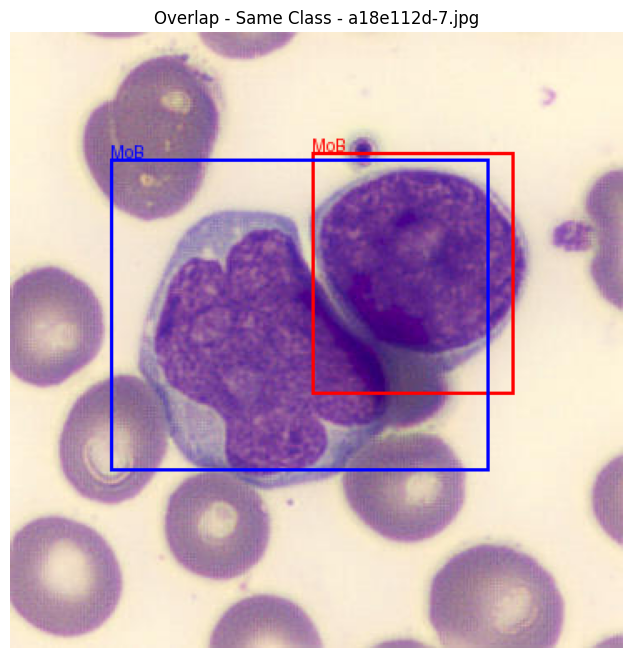

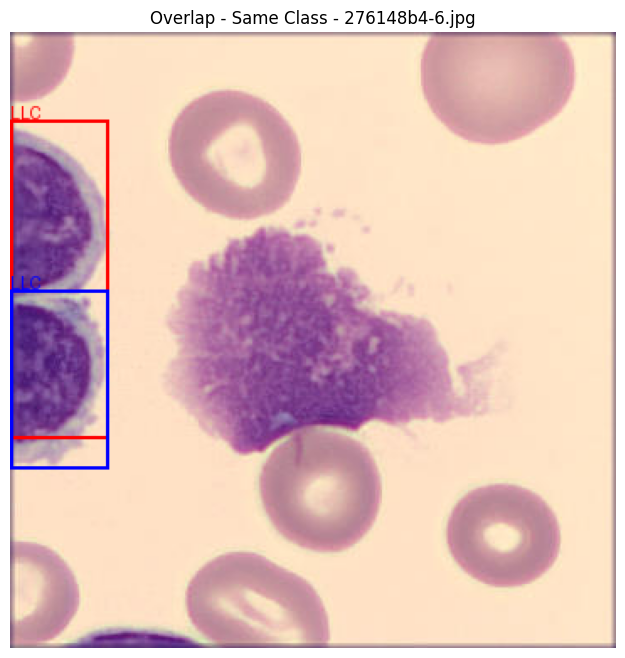

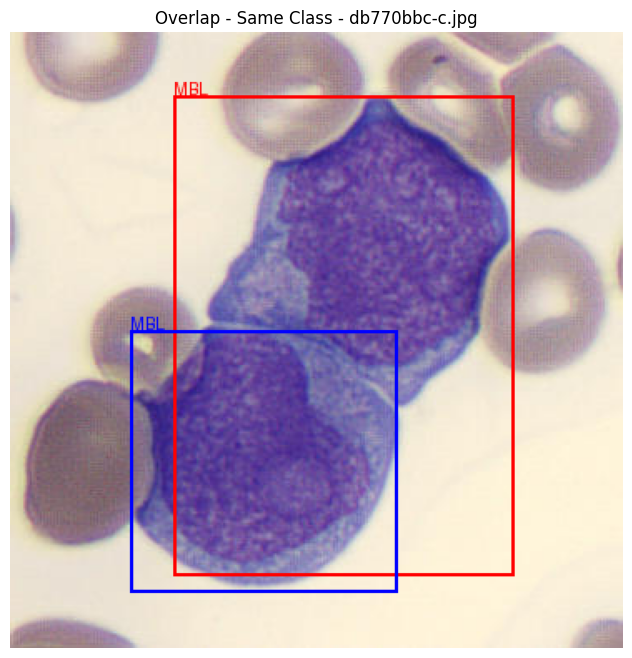

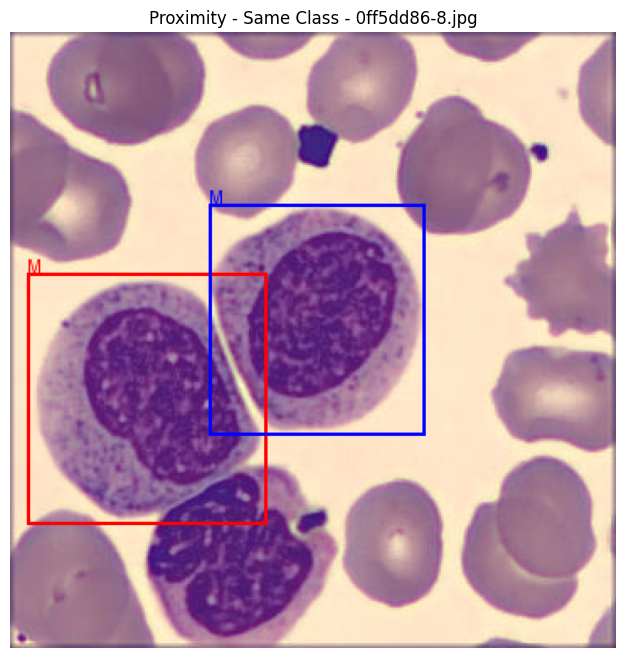

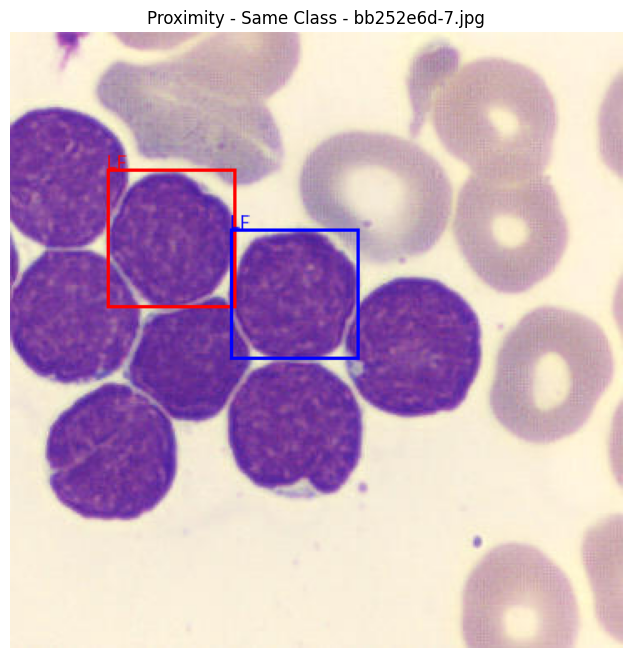

...

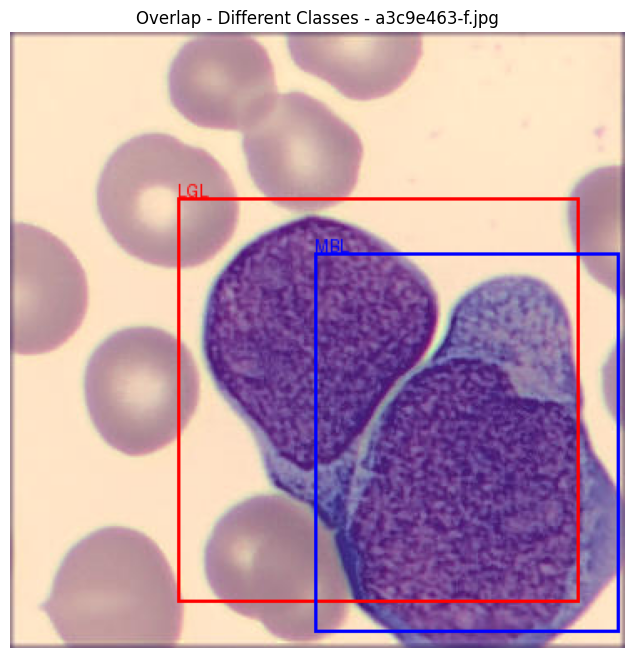

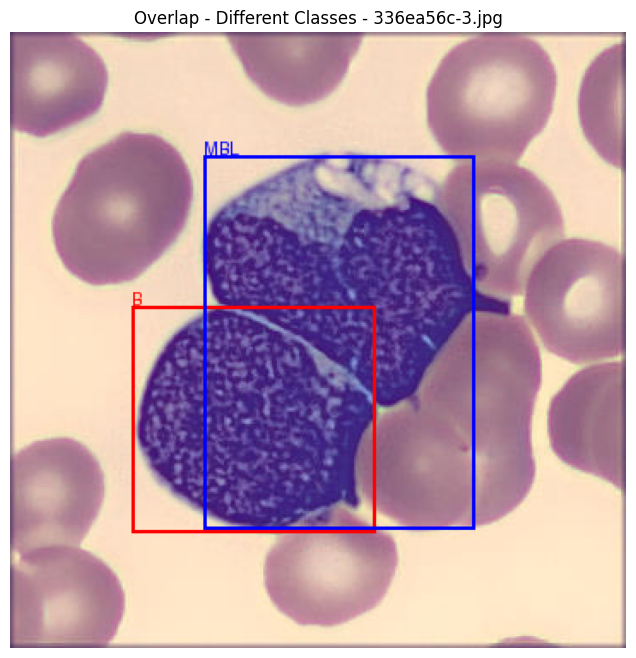

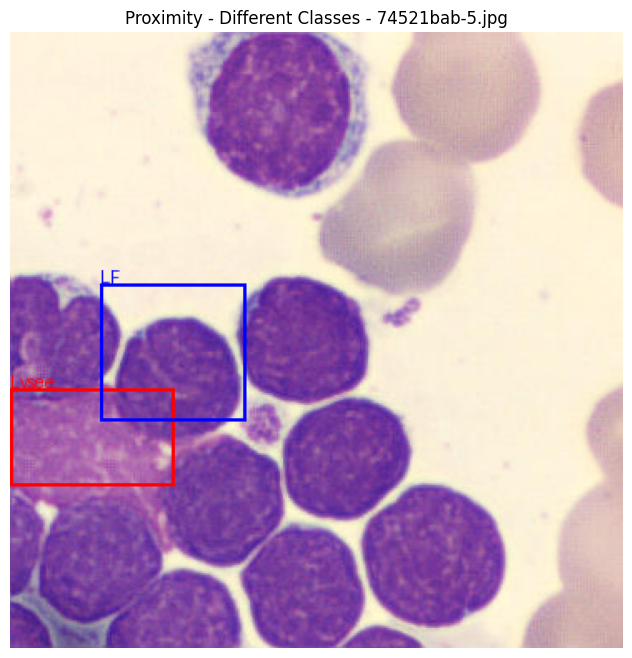

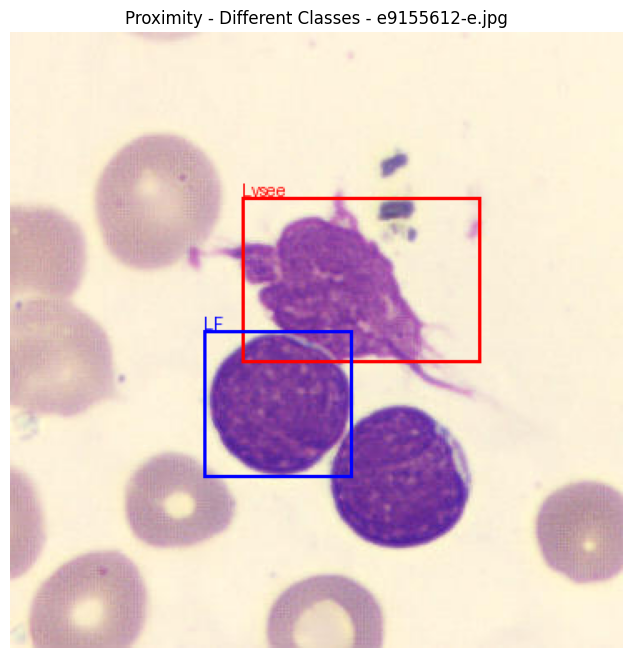

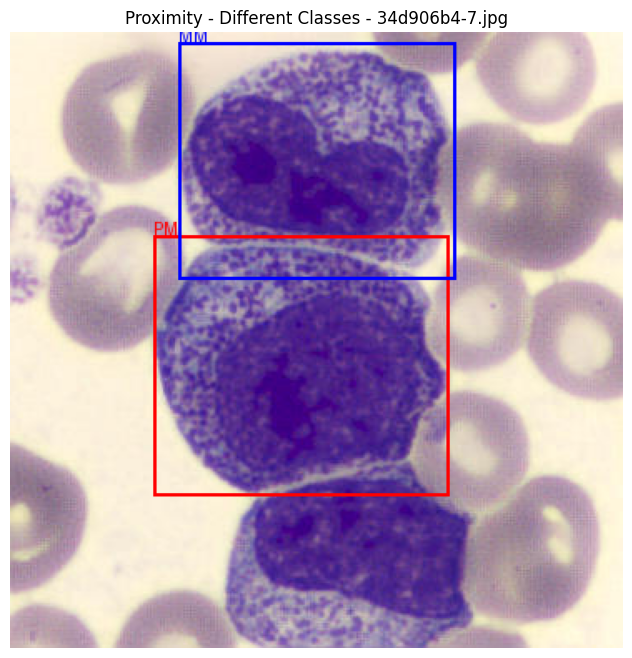

In [27]:
# Visualization function with class display
def visualize_cases(df, case_type, adjusted_df, images_path, sample_size=3):
    if df.empty:
        print(f"No {case_type} cases to display.")
        return

    sample_cases = df.sample(n=min(sample_size, len(df)), random_state=42)

    for _, row in sample_cases.iterrows():
        image_name = row['Image']
        image_path = os.path.join(images_path, image_name)

        try:
            with Image.open(image_path) as img:
                draw = ImageDraw.Draw(img)

                # Fetch first bounding box coordinates and class
                box1_row = adjusted_df.loc[row['Box1_Index']]
                box1 = [box1_row['x1'], box1_row['y1'], box1_row['x2'], box1_row['y2']]
                class1 = box1_row['class']

                # Fetch second bounding box coordinates and class
                box2_row = adjusted_df.loc[row['Box2_Index']]
                box2 = [box2_row['x1'], box2_row['y1'], box2_row['x2'], box2_row['y2']]
                class2 = box2_row['class']

                # Draw the bounding boxes
                draw.rectangle(box1, outline="red", width=2)
                draw.rectangle(box2, outline="blue", width=2)

                # Annotate the class labels
                draw.text((box1[0], box1[1] - 10), str(class1), fill="red")
                draw.text((box2[0], box2[1] - 10), str(class2), fill="blue")

                # Display the image with bounding boxes
                plt.figure(figsize=(8, 8))
                plt.imshow(img)
                plt.title(f"{case_type} - {image_name}")
                plt.axis('off')
                plt.show()
        except FileNotFoundError:
            print(f"Image not found: {image_path}")
        except KeyError as e:
            print(f"KeyError: {e} for image {image_name}")

# Visualize some same class overlaps and proximities
visualize_cases(df_overlaps_same, "Overlap - Same Class", adjusted_df, images_path)
visualize_cases(df_proximities_same, "Proximity - Same Class", adjusted_df, images_path)

# Visualize some different class overlaps and proximities
visualize_cases(df_overlaps_diff, "Overlap - Different Classes", adjusted_df, images_path)
visualize_cases(df_proximities_diff, "Proximity - Different Classes", adjusted_df, images_path)


## Drop all of them

In [28]:
# Combine all indices to drop
indices_to_drop = set()

# Add indices for overlapping bounding boxes (Same Class)
indices_to_drop.update(df_overlaps_same['Box1_Index'].tolist())
indices_to_drop.update(df_overlaps_same['Box2_Index'].tolist())

# Add indices for overlapping bounding boxes (Different Classes)
indices_to_drop.update(df_overlaps_diff['Box1_Index'].tolist())
indices_to_drop.update(df_overlaps_diff['Box2_Index'].tolist())

# Add indices for nearby bounding boxes (Same Class)
indices_to_drop.update(df_proximities_same['Box1_Index'].tolist())
indices_to_drop.update(df_proximities_same['Box2_Index'].tolist())

# Add indices for nearby bounding boxes (Different Classes)
indices_to_drop.update(df_proximities_diff['Box1_Index'].tolist())
indices_to_drop.update(df_proximities_diff['Box2_Index'].tolist())

# Drop the identified indices from the DataFrame
adjusted_df_cleaned = adjusted_df.drop(indices_to_drop)

# Reset the index of the cleaned DataFrame
adjusted_df_cleaned.reset_index(drop=True, inplace=True)

# Display results
print(f"Original DataFrame size: {len(adjusted_df)}")
print(f"Cleaned DataFrame size: {len(adjusted_df_cleaned)}")
print(f"Number of rows dropped: {len(adjusted_df) - len(adjusted_df_cleaned)}")


Original DataFrame size: 52748
Cleaned DataFrame size: 46124
Number of rows dropped: 6624


In [29]:
# Reinitialize lists to store overlaps and proximities
overlaps_same_class = []
overlaps_diff_class = []
proximities_same_class = []
proximities_diff_class = []

# Iterate through each image in the cleaned DataFrame
for image_name, group in adjusted_df_cleaned.groupby('NAME'):
    boxes = group[['x1', 'y1', 'x2', 'y2']].values
    classes = group['class'].values
    indices = group.index.tolist()

    # Iterate through all unique pairs of boxes in the image
    for (i, box1, class1), (j, box2, class2) in combinations(zip(indices, boxes, classes), 2):
        iou = calculate_iou(box1, box2)
        distance = calculate_min_distance(box1, box2)

        same_class = class1 == class2

        if iou > IOU_THRESHOLD:
            if same_class:
                overlaps_same_class.append({
                    'Image': image_name,
                    'Box1_Index': i,
                    'Box2_Index': j,
                    'Class': class1,
                    'IoU': iou
                })
            else:
                overlaps_diff_class.append({
                    'Image': image_name,
                    'Box1_Index': i,
                    'Box2_Index': j,
                    'Class1': class1,
                    'Class2': class2,
                    'IoU': iou
                })
        elif distance < DISTANCE_THRESHOLD:
            if same_class:
                proximities_same_class.append({
                    'Image': image_name,
                    'Box1_Index': i,
                    'Box2_Index': j,
                    'Class': class1,
                    'Distance': distance
                })
            else:
                proximities_diff_class.append({
                    'Image': image_name,
                    'Box1_Index': i,
                    'Box2_Index': j,
                    'Class1': class1,
                    'Class2': class2,
                    'Distance': distance
                })

# Convert lists to DataFrames for better visualization
df_overlaps_same_cleaned = pd.DataFrame(overlaps_same_class)
df_overlaps_diff_cleaned = pd.DataFrame(overlaps_diff_class)
df_proximities_same_cleaned = pd.DataFrame(proximities_same_class)
df_proximities_diff_cleaned = pd.DataFrame(proximities_diff_class)

# Display the updated results
print("\nAfter Dropping:")
print(f"Total overlapping bounding boxes (Same Class): {len(df_overlaps_same_cleaned)}")
print(f"Total overlapping bounding boxes (Different Classes): {len(df_overlaps_diff_cleaned)}")
print(f"Total nearby bounding boxes (Same Class): {len(df_proximities_same_cleaned)}")
print(f"Total nearby bounding boxes (Different Classes): {len(df_proximities_diff_cleaned)}")



After Dropping:
Total overlapping bounding boxes (Same Class): 0
Total overlapping bounding boxes (Different Classes): 0
Total nearby bounding boxes (Same Class): 0
Total nearby bounding boxes (Different Classes): 0


# Data Balancing

In [30]:
import pandas as pd

# Original class distribution
class_distribution = adjusted_df['class'].value_counts().sort_values(ascending=False)
print("Original Class Distribution:")
print(class_distribution)

# Define target size (half of the largest class)
target_size = class_distribution.max() // 2
print(f"\nTarget size for each class: {target_size}")

# Identify classes that need augmentation
classes_to_augment = class_distribution[class_distribution < target_size].index.tolist()
print("\nClasses to augment:")
print(classes_to_augment)


Original Class Distribution:
class
PNN         6827
Lysee       3408
LAM3        3338
LLC         3158
LyB         3029
MO          2743
MBL         2668
LGL         2439
EO          2432
Thromb      2319
Er          2308
B           2263
LF          2131
LY          2092
M           1994
MM          1707
LH_lyAct    1705
MoB         1531
PM          1152
BA          1001
LM           944
LZMG         845
SS           714
Name: count, dtype: int64

Target size for each class: 3413

Classes to augment:
['Lysee', 'LAM3', 'LLC', 'LyB', 'MO', 'MBL', 'LGL', 'EO', 'Thromb', 'Er', 'B', 'LF', 'LY', 'M', 'MM', 'LH_lyAct', 'MoB', 'PM', 'BA', 'LM', 'LZMG', 'SS']


In [31]:
# import albumentations as A
# from albumentations.pytorch import ToTensorV2
# import numpy as np

# augmentation_pipeline = A.Compose([
#     A.HorizontalFlip(p=0.5),
#     A.Rotate(limit=30, p=0.5),
#     A.RandomBrightnessContrast(p=0.5),
# ], bbox_params=A.BboxParams(
#     format='pascal_voc',  # x_min, y_min, x_max, y_max
#     label_fields=['category_ids'],
#     min_area=1,
#     min_visibility=0.1
# ))

# def augment_data(df, images_path, augmentation_pipeline, target_size=3413, max_augmentations=5):
#     """
#     Augment data for classes to reach the target size.

#     Parameters:
#     - df: Original DataFrame with bounding boxes and class labels.
#     - images_path: Path to the directory containing images.
#     - augmentation_pipeline: Albumentations Compose object with desired augmentations.
#     - target_size: Desired number of samples per class.
#     - max_augmentations: Maximum number of augmentation attempts per original sample.

#     Returns:
#     - balanced_df: DataFrame with original and augmented data.
#     - augmentation_failures: List of bounding boxes that couldn't be augmented successfully.
#     """
#     augmented_data = []
#     augmentation_failures = []

#     # Group the DataFrame by class
#     class_groups = df.groupby('class')

#     for cls, group in class_groups:
#         current_count = len(group)
#         if current_count >= target_size:
#             continue  # Skip classes that already meet or exceed the target

#         needed_samples = target_size - current_count
#         print(f"Augmenting class '{cls}': Current={current_count}, Needed={needed_samples}")

#         group_shuffled = group.sample(frac=1, random_state=42).reset_index(drop=True)

#         for idx, row in group_shuffled.iterrows():
#             if needed_samples <= 0:
#                 break

#             image_name = row['NAME']
#             image_path = os.path.join(images_path, image_name)

#             try:
#                 image = np.array(Image.open(image_path))
#             except FileNotFoundError:
#                 print(f"Image not found: {image_path}")
#                 continue

#             bbox = [row['x1'], row['y1'], row['x2'], row['y2']]
#             category_ids = [cls]

#             for attempt in range(max_augmentations):
#                 augmented = augmentation_pipeline(image=image, bboxes=[bbox], category_ids=category_ids)
#                 augmented_image = augmented['image']
#                 augmented_bboxes = augmented['bboxes']
#                 augmented_classes = augmented['category_ids']

#                 if len(augmented_bboxes) == 0:
#                     continue

#                 augmented_bbox = augmented_bboxes[0]
#                 augmented_class = augmented_classes[0]

#                 base_name, ext = os.path.splitext(image_name)
#                 augmented_image_name = f"{base_name}_aug_{idx}_{attempt+1}{ext}"

#                 # Append the augmented data
#                 augmented_data.append({
#                     'NAME': augmented_image_name,
#                     'x1': int(max(0, augmented_bbox[0])),
#                     'y1': int(max(0, augmented_bbox[1])),
#                     'x2': int(min(augmented_bbox[2], image.shape[1])),
#                     'y2': int(min(augmented_bbox[3], image.shape[0])),
#                     'class': augmented_class,
#                     'fixed_border': False,  # Augmented boxes are not "fixed"
#                     'frame_inside_frame': False,  # Assumes no nested boxes in aug
#                     'is_augmented': True  # Mark as augmented
#                 })

#                 needed_samples -= 1
#                 break

#     # Combine original and augmented data
#     augmented_df = pd.DataFrame(augmented_data)
#     balanced_df = pd.concat([df, augmented_df], ignore_index=True)

#     return balanced_df, augmentation_failures

# # 3413 is target size
# augmented_df, failures = augment_data(adjusted_df_cleaned, "/content/Images/dataset_cytologia", augmentation_pipeline, target_size=3413)
# print(f"\nData augmentation completed. Failures: {len(failures)}")


In [32]:
# print("\nFinal class distribution:")
# print(augmented_df['class'].value_counts().sort_values(ascending=False))


# Detect nested boxes

In [33]:
def detect_nested_boxes(df):
    """
    Detect bounding boxes that are nested inside other bounding boxes.

    Parameters:
    - df: DataFrame containing bounding box data with columns ['NAME', 'x1', 'y1', 'x2', 'y2'].

    Returns:
    - df_with_nested: DataFrame with an added 'frame_inside_frame' column.
    - nested_details: List of nested bounding box pairs.
    """
    nested_details = []
    df['frame_inside_frame'] = False  # Initialize column

    # Group by image to check boxes within the same image
    for image_name, group in df.groupby('NAME'):
        for idx_a, row_a in group.iterrows():
            for idx_b, row_b in group.iterrows():
                if idx_a == idx_b:
                    continue

                # Check if box A is inside box B
                if (row_a['x1'] >= row_b['x1'] and row_a['y1'] >= row_b['y1'] and
                    row_a['x2'] <= row_b['x2'] and row_a['y2'] <= row_b['y2']):
                    df.at[idx_a, 'frame_inside_frame'] = True
                    nested_details.append((image_name, idx_a, idx_b))

    return df, nested_details

final_df,_ = detect_nested_boxes(adjusted_df_cleaned)

In [34]:
import re

# Function to clean augmented suffix from filenames
def clean_augmented_filenames(name):
    return re.sub(r'_aug_\d+_\d+', '', name)  # Removes "_aug_123_456"

# Apply cleaning function to the 'NAME' column
final_df['NAME'] = final_df['NAME'].apply(clean_augmented_filenames)

# Verify cleaning
print("Sample cleaned filenames:")
print(final_df['NAME'].unique()[:10])  # Display first 10 cleaned filenames


Sample cleaned filenames:
['cf7734a2-b.jpg' 'e6a3b579-0.jpg' '60f95776-f.jpg' '0894e581-c.jpg'
 '3998a979-3.jpg' '46ce4b0c-a.jpg' 'eacb2ac6-f.jpg' '6873cffa-f.jpg'
 '78ca7bad-b.jpg' '924602ae-6.jpg']


In [35]:
print("\nFinal class distribution:")
print(final_df['class'].value_counts().sort_values(ascending=False))



Final class distribution:
class
PNN         6346
Lysee       2991
LAM3        2937
MO          2598
LyB         2460
LGL         2385
LLC         2335
MBL         2296
EO          2277
Thromb      2237
Er          2195
M           1872
LY          1869
B           1855
LH_lyAct    1634
MM          1615
PM          1087
LF          1058
BA           973
MoB          948
LM           750
LZMG         707
SS           699
Name: count, dtype: int64


In [36]:
from collections import Counter
from PIL import Image
import matplotlib.pyplot as plt

# Dictionary to store resolutions
resolution_counter = Counter()

# Iterate through each image in the DataFrame
for image_name in final_df['NAME'].unique():
    image_path = os.path.join(images_path, image_name)
    try:
        with Image.open(image_path) as img:
            resolution = f"{img.width}x{img.height}"
            resolution_counter[resolution] += 1
    except FileNotFoundError:
        print(f"Image not found: {image_path}")

# Convert resolution counter to a sorted DataFrame for better visualization
resolution_df = (
    pd.DataFrame.from_dict(resolution_counter, orient="index", columns=["Frequency"])
    .reset_index()
    .rename(columns={"index": "Resolution"})
    .sort_values(by="Frequency", ascending=False)
)



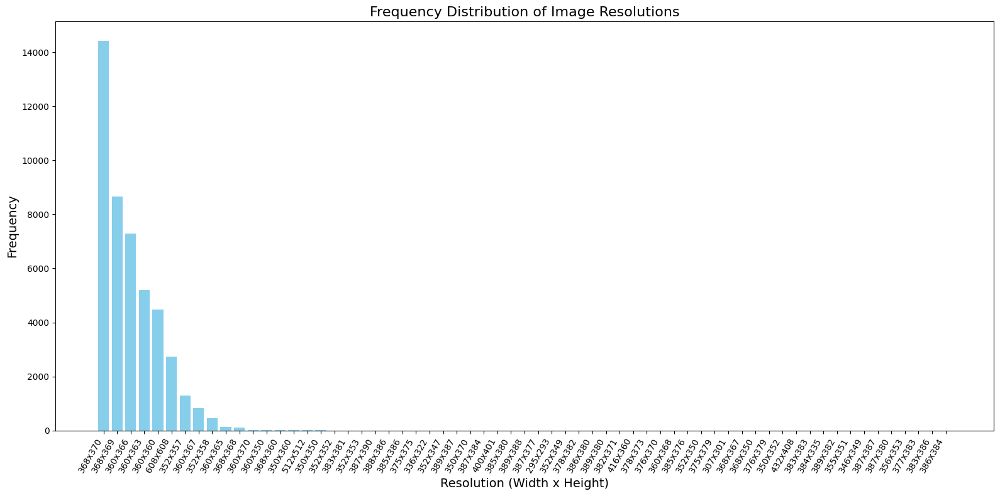

In [37]:
# Plot the frequency distribution of resolutions
plt.figure(figsize=(16, 8))
plt.bar(resolution_df['Resolution'], resolution_df['Frequency'], color='skyblue')
plt.title("Frequency Distribution of Image Resolutions", fontsize=16)
plt.xlabel("Resolution (Width x Height)", fontsize=14)
plt.ylabel("Frequency", fontsize=14)
plt.xticks(rotation=60, ha="right", fontsize=10)
plt.tight_layout()

plt.show()


# Resizing and scaling the bounding boxes

In [38]:
import os
import shutil

transformed_images_path = '/content/Images/Adjusted_size'
if os.path.exists(transformed_images_path):
    shutil.rmtree(transformed_images_path)
print("Old resized-images folder deleted.")

Old resized-images folder deleted.


In [39]:
import os
from PIL import Image
import pandas as pd
import matplotlib.pyplot as plt

# Define the target resolution
TARGET_WIDTH = 352
TARGET_HEIGHT = 357

# Path to your images directory
images_path = '/content/Images/dataset_cytologia'
os.makedirs(transformed_images_path, exist_ok=True)

# 1) Drop exact duplicates of bounding boxes if they exist
final_df.drop_duplicates(subset=['NAME','x1','y1','x2','y2'], inplace=True)

def resize_and_adjust_boxes(row):
    image_name = row['NAME']
    boxes = row[['x1', 'y1', 'x2', 'y2']].copy()  # Make a copy to avoid warning
    image_path = os.path.join(images_path, image_name)
    transformed_image_path = os.path.join(transformed_images_path, image_name)

    try:
        with Image.open(image_path) as img:
            orig_width, orig_height = img.width, img.height

            # Calculate scaling factors
            scale_x = TARGET_WIDTH / orig_width
            scale_y = TARGET_HEIGHT / orig_height

            # Resize and save the image
            img_resized = img.resize((TARGET_WIDTH, TARGET_HEIGHT), resample=Image.Resampling.LANCZOS)
            img_resized.save(transformed_image_path)

            # Adjust bounding boxes
            boxes['x1'] = int(boxes['x1'] * scale_x)
            boxes['y1'] = int(boxes['y1'] * scale_y)
            boxes['x2'] = int(boxes['x2'] * scale_x)
            boxes['y2'] = int(boxes['y2'] * scale_y)

            # Overwrite the original row columns so we only have one set
            row[['x1','y1','x2','y2']] = boxes

            row['status'] = True
            return row
    except Exception as e:
        print(f"Error processing {image_name}: {e}")
        row['status'] = False
        return row

# Apply the resizing and bounding box adjustment
final_df = final_df.apply(resize_and_adjust_boxes, axis=1)

# Filter for successfully transformed images
transformed_df = final_df[final_df['status'] == True].copy()

# Save the transformed bounding box data
transformed_df.drop(columns=['status'], inplace=True)
transformed_df.to_csv('transformed_bounding_boxes.csv', index=False)

print("Transformed images saved and bounding boxes adjusted.")

Transformed images saved and bounding boxes adjusted.


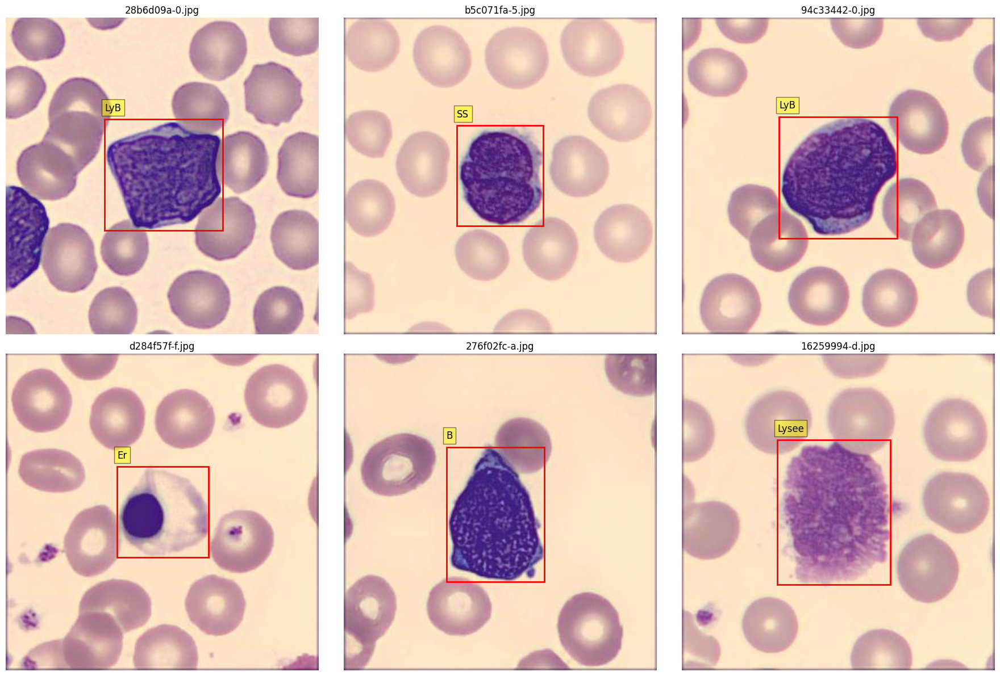

In [40]:
import random

# Function to visualize images with bounding boxes and labels
def visualize_samples(df, images_dir, num_samples=6):
    # Ensure there are enough unique images
    unique_images = df['NAME'].unique()
    if len(unique_images) < num_samples:
        print(f"Not enough unique images to display. Found only {len(unique_images)} images.")
        num_samples = len(unique_images)

    # Randomly select sample images
    sample_images = random.sample(list(unique_images), num_samples)

    # Set up the matplotlib figure
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    axes = axes.flatten()

    for idx, image_name in enumerate(sample_images):
        ax = axes[idx]
        image_path = os.path.join(images_dir, image_name)

        try:
            with Image.open(image_path) as img:
                ax.imshow(img)
                ax.axis('off')  # Hide axes

                # Get all bounding boxes for this image
                image_boxes = df[df['NAME'] == image_name]

                for _, box in image_boxes.iterrows():
                    x1, y1, x2, y2 = box['x1'], box['y1'], box['x2'], box['y2']
                    label = box.get('class', 'N/A')

                    # Draw rectangle
                    rect = plt.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                         linewidth=2, edgecolor='red', facecolor='none')
                    ax.add_patch(rect)

                    # Add label
                    ax.text(x1, y1 - 10, label,
                            bbox=dict(facecolor='yellow', alpha=0.5),
                            fontsize=12, color='black')

                ax.set_title(image_name)
        except Exception as e:
            print(f"Error loading image {image_name}: {e}")
            ax.axis('off')
            ax.set_title(f"Error loading {image_name}")

    # Hide any unused subplots
    for i in range(num_samples, len(axes)):
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

# Call the visualization function
visualize_samples(transformed_df, transformed_images_path, num_samples=6)

In [41]:
# Check for bounding boxes in final_df for the specific image
image_name = "6dc7c791-1.jpg"
filtered_df = final_df[final_df['NAME'] == image_name]

# Display the filtered DataFrame and the number of bounding boxes
print(filtered_df)
print(f"Number of bounding boxes for {image_name}: {len(filtered_df)}")


                 NAME   x1   y1   x2   y2   class  fixed_border  \
44033  6dc7c791-1.jpg  144  149  212  211  Thromb         False   

       frame_inside_frame  status  
44033               False    True  
Number of bounding boxes for 6dc7c791-1.jpg: 1


In [ ]:
import os
import pandas as pd
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')

# Define paths
drive_path = '/content/drive/My Drive/adjusted_machine_lecko'
transformed_images_path = '/content/Images/Adjusted_size'
drive_transformed_images_path = os.path.join(drive_path, 'transformed_images')
drive_csv_path = os.path.join(drive_path, 'transformed_bounding_boxes.csv')

# Create directories in Drive if they don't exist
os.makedirs(drive_transformed_images_path, exist_ok=True)

# Copy transformed images to Google Drive
for image_name in os.listdir(transformed_images_path):
    source_path = os.path.join(transformed_images_path, image_name)
    destination_path = os.path.join(drive_transformed_images_path, image_name)
    try:
        if os.path.isfile(source_path):  # Check if it's a file
            os.system(f'cp "{source_path}" "{destination_path}"')
    except Exception as e:
        print(f"Error copying {image_name}: {e}")

# Load the transformed bounding boxes data
transformed_df = pd.read_csv('transformed_bounding_boxes.csv')

# Save the CSV to Google Drive
transformed_df.to_csv(drive_csv_path, index=False)

print(f"Transformed images and bounding box CSV saved to Google Drive:")
print(f"Images: {drive_transformed_images_path}")
print(f"CSV: {drive_csv_path}")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Transformed images and bounding box CSV saved to Google Drive:
Images: /content/drive/My Drive/adjusted_machine_lecko/transformed_images
CSV: /content/drive/My Drive/adjusted_machine_lecko/transformed_bounding_boxes.csv


In [ ]:
# import os
# import random
# import matplotlib.pyplot as plt
# import matplotlib.patches as patches
# import pandas as pd
# from PIL import Image
# import matplotlib.colors as mcolors
# from itertools import cycle

# # Configuration
# TARGET_WIDTH = 352
# TARGET_HEIGHT = 357
# images_path = '/content/Images/dataset_cytologia'
# transformed_images_path = '/content/Images/Adjusted_size'
# os.makedirs(transformed_images_path, exist_ok=True)

# # Function to fix bounding box scaling
# def fix_scaling(row, orig_width, orig_height):
#     scale_x = TARGET_WIDTH / orig_width
#     scale_y = TARGET_HEIGHT / orig_height
#     row['x1'] = int(row['x1'] * scale_x)
#     row['y1'] = int(row['y1'] * scale_y)
#     row['x2'] = int(row['x2'] * scale_x)
#     row['y2'] = int(row['y2'] * scale_y)
#     return row

# # Preprocess DataFrame
# def preprocess_dataframe(df):
#     # Remove duplicates
#     df = df.drop_duplicates(subset=['NAME', 'x1', 'y1', 'x2', 'y2'])

#     # Remove invalid boxes
#     df = df[(df['x1'] < df['x2']) & (df['y1'] < df['y2'])]

#     # Clip coordinates to image bounds
#     df['x1'] = df['x1'].clip(0, TARGET_WIDTH)
#     df['y1'] = df['y1'].clip(0, TARGET_HEIGHT)
#     df['x2'] = df['x2'].clip(0, TARGET_WIDTH)
#     df['y2'] = df['y2'].clip(0, TARGET_HEIGHT)

#     return df

# # Visualization Function
# def visualize_samples(df, images_dir, num_samples=6, label_col='class'):
#     # Ensure there are enough unique images
#     unique_images = df['NAME'].unique()
#     if len(unique_images) < num_samples:
#         print(f"Not enough unique images to display. Found only {len(unique_images)} images.")
#         num_samples = len(unique_images)

#     # Randomly select sample images
#     sample_images = random.sample(list(unique_images), num_samples)

#     # Assign unique colors to labels
#     unique_labels = df[label_col].dropna().unique()
#     colors = cycle(mcolors.TABLEAU_COLORS)
#     label_color_map = {label: color for label, color in zip(unique_labels, colors)}

#     # Set up matplotlib figure
#     fig, axes = plt.subplots(2, 3, figsize=(18, 12))
#     axes = axes.flatten()

#     for idx, image_name in enumerate(sample_images):
#         ax = axes[idx]
#         image_path = os.path.join(images_dir, image_name)

#         try:
#             with Image.open(image_path) as img:
#                 ax.imshow(img)
#                 ax.axis('off')  # Hide axes

#                 # Get all bounding boxes for this image
#                 image_boxes = df[df['NAME'] == image_name]

#                 for _, box in image_boxes.iterrows():
#                     x1, y1, x2, y2 = box['x1'], box['y1'], box['x2'], box['y2']
#                     label = box.get(label_col, 'N/A')

#                     # Assign color based on label
#                     edge_color = label_color_map.get(label, 'red')

#                     # Draw rectangle
#                     rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1,
#                                              linewidth=2, edgecolor=edge_color, facecolor='none', alpha=0.8)
#                     ax.add_patch(rect)

#                     # Add label
#                     ax.text(x1, y1 - 10, label,
#                             bbox=dict(facecolor=edge_color, alpha=0.5),
#                             fontsize=12, color='white')

#                 ax.set_title(image_name)
#         except Exception as e:
#             print(f"Error loading image {image_name}: {e}")
#             ax.axis('off')
#             ax.set_title(f"Error loading {image_name}")

#     # Hide unused subplots
#     for i in range(num_samples, len(axes)):
#         axes[i].axis('off')

#     plt.tight_layout()
#     plt.show()


# transformed_df = preprocess_dataframe(transformed_df)



In [ ]:
# visualize_samples(transformed_df, transformed_images_path, num_samples=6, label_col='class')

In [ ]:
print(transformed_df.columns)


Index(['NAME', 'x1', 'y1', 'x2', 'y2', 'class', 'fixed_border',
       'frame_inside_frame', 'is_augmented'],
      dtype='object')


In [ ]:
# def downsample_all_classes_to_least(
#     df,
#     fixed_border_col='fixed_border',
#     nested_box_col='frame_inside_frame',
#     augmented_col='is_augmented',
#     target_size=1428
# ):
#     """
#     Downsample all classes to the specified target size.
#     Preserves 'special' samples (fixed_border or frame_inside_frame) first
#     and prioritizes non-augmented samples over augmented. Guarantees the target size
#     even if priority constraints are not fully met.

#     Parameters:
#     - df: pandas DataFrame with columns:
#         'class' (str),
#         fixed_border_col (bool),
#         nested_box_col (bool),
#         augmented_col (bool).
#     - fixed_border_col: Name of the boolean column indicating out-of-bound fixes.
#     - nested_box_col: Name of the boolean column indicating nested bounding boxes.
#     - augmented_col: Name of the boolean column indicating if the image is augmented.
#     - target_size: Desired size for all classes after downsampling.

#     Returns:
#     - downsampled_df: DataFrame where each class has exactly `target_size` rows.
#     """

#     # Helper function: "smart sample" (prioritize non-aug over aug)
#     def smart_sample(df_subset, n_needed):
#         """
#         Samples n_needed rows from df_subset, prioritizing non-aug first,
#         then aug if needed.
#         """
#         df_non_aug = df_subset[df_subset[augmented_col] == False]
#         df_aug = df_subset[df_subset[augmented_col] == True]

#         non_aug_count = len(df_non_aug)
#         if non_aug_count >= n_needed:
#             # All from non-aug
#             return df_non_aug.sample(n=n_needed, random_state=42)
#         else:
#             # Use all non-aug + remainder from aug
#             remainder = n_needed - non_aug_count
#             sampled_non_aug = df_non_aug.sample(n=non_aug_count, random_state=42)
#             if len(df_aug) >= remainder:
#                 sampled_aug = df_aug.sample(n=remainder, random_state=42)
#             else:
#                 # If not enough augmented to fill remainder, take whatever is available
#                 sampled_aug = df_aug.sample(n=len(df_aug), random_state=42)
#                 print(
#                     f"Warning: not enough augmented samples to reach n_needed={n_needed}. "
#                     f"Subset had {len(df_subset)} total."
#                 )
#             return pd.concat([sampled_non_aug, sampled_aug], ignore_index=True)

#     # Prepare output
#     downsampled_data = []

#     # Iterate over classes
#     for cls in df['class'].unique():
#         class_df = df[df['class'] == cls].reset_index(drop=True)  # Reset index to avoid mismatch
#         current_count = len(class_df)

#         if current_count <= target_size:
#             # Already at or below the target size, keep all
#             downsampled_data.append(class_df)
#             print(
#                 f"Class '{cls}': {current_count} samples <= target ({target_size}). "
#                 f"No downsampling applied."
#             )
#             continue

#         # Split into 'special' vs 'regular'
#         special_df = class_df[
#             (class_df[fixed_border_col] == True) |
#             (class_df[nested_box_col] == True)
#         ].reset_index(drop=True)  # Reset index
#         regular_df = class_df[
#             (class_df[fixed_border_col] == False) &
#             (class_df[nested_box_col] == False)
#         ].reset_index(drop=True)  # Reset index

#         special_count = len(special_df)

#         # CASE A: If special_df alone > target_size, downsample from special
#         if special_count > target_size:
#             print(
#                 f"Class '{cls}' total={current_count}, special={special_count} > target={target_size}. "
#                 f"Downsampling special subset."
#             )
#             # Prioritize non-aug among the special subset
#             downsampled_special = smart_sample(special_df, target_size)
#             downsampled_data.append(downsampled_special)
#             continue

#         # CASE B: If special_df <= target_size:
#         #  - Keep all special
#         #  - Fill the remainder from regular, prioritizing non-aug
#         needed_from_regular = target_size - special_count
#         downsampled_regular = smart_sample(regular_df, needed_from_regular)

#         # Combine special + regular
#         combined_df = pd.concat([special_df, downsampled_regular], ignore_index=True)

#         # CASE C: Fallback sampling if target size is still not met
#         if len(combined_df) < target_size:
#             shortfall = target_size - len(combined_df)
#             fallback_df = class_df.drop(combined_df.index).sample(
#                 n=shortfall, random_state=42, replace=False
#             )
#             combined_df = pd.concat([combined_df, fallback_df], ignore_index=True)
#             print(
#                 f"Class '{cls}' total={current_count}, unable to meet priority rules. "
#                 f"Added {shortfall} rows from fallback sampling."
#             )

#         downsampled_data.append(combined_df)
#         print(
#             f"Class '{cls}' total={current_count} downsampled to {target_size}. "
#             f"Kept {special_count} special, took {len(downsampled_regular)} from regular."
#         )

#     # Combine all downsampled classes
#     downsampled_df = pd.concat(downsampled_data, ignore_index=True)

#     return downsampled_df


In [43]:
import pandas as pd

def downsample_all_classes_to_target(
    df,
    image_id_col='image_id',
    class_col='class',
    fixed_border_col='fixed_border',
    nested_box_col='frame_inside_frame',
    target_size=600
):
    """
    Downsample all classes to the specified target size, grouping by image.
    Ensures that if any bounding box for an image is included, *all* bounding boxes
    for that image are included. We aim for ~ target_size rows per class but may exceed it
    in cases where the last chosen image pushes the total beyond `target_size`.

    Parameters
    ----------
    df : pandas.DataFrame
        DataFrame that includes:
          - A class column (default "class_col")
          - An image ID column (default "image_id_col")
          - Possibly other boolean columns indicating out-of-bound fixes, nested boxes, etc.
    image_id_col : str
        Column name for the image identifier.
    class_col : str
        Column name for the class label.
    fixed_border_col : str
        Column name for the boolean indicating out-of-bound fixes.
    nested_box_col : str
        Column name for the boolean indicating nested bounding boxes.
    target_size : int
        Desired approximate size for all classes after downsampling.

    Returns
    -------
    downsampled_df : pandas.DataFrame
        DataFrame where each class has approximately `target_size` rows (may exceed).
        All bounding boxes from a chosen image are included together.
    """

    # Prepare output storage
    downsampled_data = []

    # Iterate over each unique class
    for cls in df[class_col].unique():
        class_df = df[df[class_col] == cls].copy()
        class_df.reset_index(drop=True, inplace=True)

        current_count = len(class_df)
        if current_count <= target_size:
            # Already at or below the target size, keep all
            downsampled_data.append(class_df)
            print(
                f"Class '{cls}': {current_count} samples <= target ({target_size}). "
                f"No downsampling applied."
            )
            continue

        # Group by image to ensure if one bounding box from the image is included,
        # all bounding boxes from that image are included
        # ----------------------------------------------------
        grouped = class_df.groupby(image_id_col)

        # Each group is essentially all bounding boxes for one image
        # We'll store tuples of (image_id, group_size) for random sampling
        image_sizes = []
        for img_id, group_rows in grouped:
            image_sizes.append((img_id, len(group_rows)))

        # Randomize the order of images before we pick them
        image_sizes_df = pd.DataFrame(image_sizes, columns=[image_id_col, 'count'])
        image_sizes_df = image_sizes_df.sample(frac=1, random_state=42).reset_index(drop=True)

        # Now accumulate images until we reach or exceed target_size
        chosen_image_ids = []
        running_total = 0

        for idx, row in image_sizes_df.iterrows():
            running_total += row['count']
            chosen_image_ids.append(row[image_id_col])
            # Once we have at least target_size rows, we stop
            if running_total >= target_size:
                break

        # Filter class_df to only the chosen images
        downsampled_class = class_df[class_df[image_id_col].isin(chosen_image_ids)]

        final_count = len(downsampled_class)
        downsampled_data.append(downsampled_class)

        print(
            f"Class '{cls}': total={current_count}, "
            f"downsampled to ~{final_count} (target was {target_size})."
        )

    # Combine all downsampled classes
    downsampled_df = pd.concat(downsampled_data, ignore_index=True)
    return downsampled_df


In [ ]:
# downsampled_df = downsample_all_classes_to_least(
#     df=final_df,  # The DataFrame after augmentation and bounding-box fixes
#     fixed_border_col='fixed_border',
#     nested_box_col='frame_inside_frame',
#     augmented_col='is_augmented',
#     target_size=1428  # Target number of samples per class
# )

# print("\nDownsampling complete. Final class distribution:")
# print(downsampled_df['class'].value_counts().sort_values(ascending=False))


In [44]:
downsampled_df = downsample_all_classes_to_target(
    df=final_df,
    image_id_col='NAME',
    fixed_border_col='fixed_border',
    nested_box_col='frame_inside_frame',
    target_size=600
)


Class 'PNN': total=6346, downsampled to ~600 (target was 600).
Class 'MO': total=2598, downsampled to ~600 (target was 600).
Class 'MM': total=1615, downsampled to ~600 (target was 600).
Class 'LyB': total=2460, downsampled to ~600 (target was 600).
Class 'LGL': total=2385, downsampled to ~600 (target was 600).
Class 'Thromb': total=2237, downsampled to ~600 (target was 600).
Class 'LAM3': total=2937, downsampled to ~600 (target was 600).
Class 'LY': total=1869, downsampled to ~600 (target was 600).
Class 'BA': total=973, downsampled to ~600 (target was 600).
Class 'MoB': total=948, downsampled to ~600 (target was 600).
Class 'LH_lyAct': total=1634, downsampled to ~600 (target was 600).
Class 'EO': total=2277, downsampled to ~600 (target was 600).
Class 'Lysee': total=2991, downsampled to ~600 (target was 600).
Class 'Er': total=2195, downsampled to ~600 (target was 600).
Class 'LZMG': total=707, downsampled to ~600 (target was 600).
Class 'MBL': total=2296, downsampled to ~600 (target

In [ ]:
x['class'].value_counts().sort_values(ascending=False).count()

23

In [ ]:
# import albumentations as A
# from albumentations.pytorch import ToTensorV2
# from PIL import Image
# import numpy as np
# import os
# import pandas as pd
# from sklearn.utils import shuffle


In [ ]:
# # Define the augmentation pipeline
# augmentation_pipeline = A.Compose([
#     A.HorizontalFlip(p=0.5),
#     A.VerticalFlip(p=0.5),
#     A.Rotate(limit=30, p=0.5),  # Rotate between -30 to 30 degrees
#     A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=15, p=0.5),
#     A.RandomBrightnessContrast(p=0.5),
# ], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['category_ids']))


In [ ]:
# import albumentations as A
# from albumentations.pytorch import ToTensorV2
# from PIL import Image
# import numpy as np
# import os
# import matplotlib.pyplot as plt
# import matplotlib.patches as patches
# import pandas as pd

# def augment_data(df, images_path, augmentation_pipeline, target_size=3413, max_augmentations=5):
#     """
#     Augment data for classes to reach the target size.

#     Parameters:
#     - df: Original DataFrame with bounding boxes and class labels.
#     - images_path: Path to the directory containing images.
#     - augmentation_pipeline: Albumentations Compose object with desired augmentations.
#     - target_size: Desired number of samples per class.
#     - max_augmentations: Maximum number of augmentation attempts per original sample.

#     Returns:
#     - balanced_df: DataFrame with original and augmented data.
#     - augmentation_failures: List of bounding boxes that couldn't be augmented successfully.
#     """
#     augmented_data = []
#     augmentation_failures = []

#     # Group the DataFrame by class
#     class_groups = df.groupby('class')

#     for cls, group in class_groups:
#         current_count = len(group)
#         if current_count >= target_size:
#             continue  # Skip classes that already meet or exceed the target

#         needed_samples = target_size - current_count
#         print(f"Augmenting class '{cls}': Current={current_count}, Needed={needed_samples}")

#         # Iterate through the group and apply augmentations
#         # To ensure diversity, shuffle the group
#         group_shuffled = group.sample(frac=1, random_state=42).reset_index(drop=True)

#         for idx, row in group_shuffled.iterrows():
#             if needed_samples <= 0:
#                 break  # Stop if target is reached

#             image_name = row['NAME']
#             image_path = os.path.join(images_path, image_name)

#             # Load the image
#             try:
#                 image = np.array(Image.open(image_path))
#             except FileNotFoundError:
#                 print(f"Image not found: {image_path}")
#                 continue

#             bbox = [row['x1'], row['y1'], row['x2'], row['y2']]
#             category_ids = [cls]

#             # Attempt augmentation up to max_augmentations times
#             for attempt in range(max_augmentations):
#                 augmented = augmentation_pipeline(image=image, bboxes=[bbox], category_ids=category_ids)
#                 augmented_image = augmented['image']
#                 augmented_bboxes = augmented['bboxes']
#                 augmented_classes = augmented['category_ids']

#                 if len(augmented_bboxes) == 0:
#                     # Augmentation resulted in no bounding boxes; retry
#                     print(f"Augmentation attempt {attempt+1} failed for image '{image_name}' and box {bbox}. Retrying...")
#                     continue

#                 # Proceed with the first augmented bounding box
#                 augmented_bbox = augmented_bboxes[0]
#                 augmented_class = augmented_classes[0]

#                 # Convert augmented image back to PIL format
#                 augmented_image_pil = Image.fromarray(augmented_image)

#                 # Generate a unique name for the augmented image
#                 # Example: originalname_aug_1.jpg
#                 base_name, ext = os.path.splitext(image_name)
#                 augmented_image_name = f"{base_name}_aug_{idx}_{attempt+1}{ext}"
#                 augmented_image_path = os.path.join(images_path, augmented_image_name)

#                 # Save the augmented image
#                 augmented_image_pil.save(augmented_image_path)

#                 # Append the augmented data to the list
#                 augmented_data.append({
#                     'NAME': augmented_image_name,
#                     'x1': int(max(0, augmented_bbox[0])),
#                     'y1': int(max(0, augmented_bbox[1])),
#                     'x2': int(min(augmented_bbox[2], Image.open(image_path).size[0])),
#                     'y2': int(min(augmented_bbox[3], Image.open(image_path).size[1])),
#                     'class': augmented_class
#                 })

#                 needed_samples -= 1
#                 break  # Successful augmentation; move to the next bounding box

#             else:
#                 # All augmentation attempts failed for this bounding box
#                 print(f"All augmentation attempts failed for image '{image_name}' and box {bbox}. Skipping.")
#                 augmentation_failures.append({
#                     'Image': image_name,
#                     'Original_Box': bbox,
#                     'Class': cls
#                 })

#     # Create a DataFrame from augmented data
#     if augmented_data:
#         augmented_df = pd.DataFrame(augmented_data)
#         # Concatenate with the original DataFrame
#         balanced_df = pd.concat([df, augmented_df], ignore_index=True)
#     else:
#         balanced_df = df.copy()

#     return balanced_df, augmentation_failures


In [ ]:
# import pandas as pd

# def downsample_overrepresented_classes_with_specials(
#     df,
#     downsample_classes,
#     fixed_border_col='fixed_border',
#     nested_box_col='frame_inside_frame'
# ):
#     """
#     Downsample specified classes to their target counts while preserving 'special' samples.

#     Parameters:
#     - df: pandas DataFrame containing the dataset.
#       Must include a 'class' column, and boolean columns indicating special samples
#       (e.g., 'fixed_border', 'frame_inside_frame').
#     - downsample_classes: Dictionary with class names as keys and target counts as values.
#     - fixed_border_col: Name of the boolean column indicating fixed-border samples.
#     - nested_box_col: Name of the boolean column indicating boxes that are nested inside another.

#     Returns:
#     - downsampled_df: DataFrame after selective downsampling, preserving special samples.
#     """
#     downsampled_data = []

#     for cls, target_count in downsample_classes.items():
#         class_df = df[df['class'] == cls]
#         current_count = len(class_df)

#         # Split into 'special' vs. 'regular' subsets
#         special_df = class_df[(class_df[fixed_border_col] == True) |
#                               (class_df[nested_box_col] == True)]
#         regular_df = class_df[(class_df[fixed_border_col] == False) &
#                               (class_df[nested_box_col] == False)]

#         special_count = len(special_df)

#         # CASE 1: If total class samples <= target_count, keep them all
#         if current_count <= target_count:
#             downsampled_data.append(class_df)
#             print(f"Class '{cls}' has {current_count} samples, which is <= target ({target_count}). No downsampling applied.")
#             continue

#         # CASE 2: If special samples alone exceed target_count, downsample special samples
#         if special_count > target_count:
#             downsampled_special_df = special_df.sample(n=target_count, random_state=42)
#             downsampled_data.append(downsampled_special_df)
#             print(
#                 f"Class '{cls}' was downsampled from {current_count} to {target_count} samples "
#                 f"entirely using special samples (because special_count={special_count} > target={target_count})."
#             )
#             continue

#         # CASE 3: If special samples are fewer than target_count, keep all special samples
#         # and fill the remainder from regular samples
#         needed_from_regular = target_count - special_count
#         downsampled_regular_df = regular_df.sample(n=needed_from_regular, random_state=42)

#         # Combine special + selected regular
#         combined_df = pd.concat([special_df, downsampled_regular_df], ignore_index=True)
#         downsampled_data.append(combined_df)

#         print(
#             f"Class '{cls}' downsampled from {current_count} to {target_count} samples. "
#             f"Preserved {special_count} special samples and took {needed_from_regular} from regular."
#         )

#     # Concatenate all class subsets
#     downsampled_df = pd.concat(downsampled_data, ignore_index=True)

#     return downsampled_df


In [ ]:
augmented_df.shape

In [ ]:
df.shape

In [ ]:
import matplotlib.pyplot as plt

def plot_class_distribution(df, title="Class Distribution"):
    """
    Plot the class distribution as a bar chart.

    Parameters:
    - df: DataFrame containing the 'class' column.
    - title: Title of the plot.
    """
    plt.figure(figsize=(14, 8))
    class_counts = df['class'].value_counts().sort_values(ascending=False)
    class_counts.plot(kind='bar', color='skyblue')
    plt.title(title, fontsize=16)
    plt.xlabel('Class', fontsize=14)
    plt.ylabel('Number of Samples', fontsize=14)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

# Plot the class distribution after augmentation
plot_class_distribution(final_downsampled_df, title="Class Distribution After Augmentation")


In [ ]:
# # Group by image name and bounding box coordinates
# grouped = df.groupby(['NAME', 'x1', 'y1', 'x2', 'y2'])

# # Find groups with more than one unique class
# conflicting_groups = grouped.filter(lambda x: x['class'].nunique() > 1)

# # Display the number of conflicting bounding boxes
# num_conflicts = conflicting_groups.shape[0]
# print(f"Number of bounding boxes with conflicting classes: {num_conflicts}")


In [ ]:
# # Group by 'NAME', 'x1', 'y1', 'x2', 'y2'
# grouped = df.groupby(['NAME', 'x1', 'y1', 'x2', 'y2'])

# # Identify groups with more than one unique class
# conflict_groups = grouped['class'].nunique().reset_index()
# conflict_groups = conflict_groups[conflict_groups['class'] > 1]

# print(f"\nNumber of conflicting bounding boxes: {conflict_groups.shape[0]}")

# # Merge to get the conflicting entries
# conflicting_entries = pd.merge(df, conflict_groups, on=['NAME', 'x1', 'y1', 'x2', 'y2'])

# # Rename for clarity
# conflicting_entries = conflicting_entries.rename(columns={'class_y': 'class_count'})

# print("\nConflicting Entries:")
# print(conflicting_entries.head())

In [ ]:
df.shape

In [ ]:
# import itertools

# # Function to check if box A is inside box B
# def is_contained(box_a, box_b):
#     return (box_a['x1'] >= box_b['x1'] and
#             box_a['y1'] >= box_b['y1'] and
#             box_a['x2'] <= box_b['x2'] and
#             box_a['y2'] <= box_b['y2'])

# # Initialize a list to store containment information
# contained_boxes = []

# # Group the DataFrame by image
# grouped = df.groupby('NAME')

# # Iterate through each image group
# for image_name, group in grouped:
#     # If there's only one bounding box, skip
#     if len(group) < 2:
#         continue
#     # Iterate through all unique pairs of bounding boxes
#     for (idx_a, box_a), (idx_b, box_b) in itertools.combinations(group.iterrows(), 2):
#         # Check if box_a is inside box_b
#         if is_contained(box_a, box_b):
#             contained_boxes.append({
#                 'Image': image_name,
#                 'Contained_Box_Index': idx_a,
#                 'Contained_Box_Class': box_a['class'],
#                 'Container_Box_Index': idx_b,
#                 'Container_Box_Class': box_b['class']
#             })
#         # Check if box_b is inside box_a
#         elif is_contained(box_b, box_a):
#             contained_boxes.append({
#                 'Image': image_name,
#                 'Contained_Box_Index': idx_b,
#                 'Contained_Box_Class': box_b['class'],
#                 'Container_Box_Index': idx_a,
#                 'Container_Box_Class': box_a['class']
#             })

# # Convert the list to a DataFrame
# contained_df = pd.DataFrame(contained_boxes)

# # Display the results
# print(f"\nTotal Contained Bounding Boxes Found: {contained_df.shape[0]}")
# print("\nSample Contained Bounding Boxes:")
# print(contained_df.head())

In [ ]:
# import matplotlib.pyplot as plt
# import matplotlib.patches as patches
# from PIL import Image

# def visualize_contained_boxes_with_classes(contained_df, df, images_path, num_samples=5):
#     # Randomly select samples to visualize
#     samples = contained_df.sample(n=min(num_samples, len(contained_df)), random_state=42)

#     for _, row in samples.iterrows():
#         image_name = row['Image']
#         contained_idx = row['Contained_Box_Index']
#         container_idx = row['Container_Box_Index']

#         # Retrieve bounding box details
#         contained_box = df.loc[contained_idx]
#         container_box = df.loc[container_idx]

#         # Load the image
#         image_path = f"{images_path}/{image_name}"
#         try:
#             image = Image.open(image_path)
#         except FileNotFoundError:
#             print(f"Image not found: {image_path}")
#             continue

#         fig, ax = plt.subplots(1, figsize=(10, 10))
#         ax.imshow(image)

#         # Draw container bounding box in blue
#         rect_container = patches.Rectangle(
#             (container_box['x1'], container_box['y1']),
#             container_box['x2'] - container_box['x1'],
#             container_box['y2'] - container_box['y1'],
#             linewidth=2,
#             edgecolor='blue',
#             facecolor='none',
#             label=f"Container: {container_box['class']}"
#         )
#         ax.add_patch(rect_container)
#         # Add class label for container
#         ax.text(
#             container_box['x1'], container_box['y1'] - 10,
#             f"{container_box['class']}",
#             color='blue', fontsize=12, fontweight='bold'
#         )

#         # Draw contained bounding box in red
#         rect_contained = patches.Rectangle(
#             (contained_box['x1'], contained_box['y1']),
#             contained_box['x2'] - contained_box['x1'],
#             contained_box['y2'] - contained_box['y1'],
#             linewidth=2,
#             edgecolor='red',
#             facecolor='none',
#             label=f"Contained: {contained_box['class']}"
#         )
#         ax.add_patch(rect_contained)
#         # Add class label for contained
#         ax.text(
#             contained_box['x1'], contained_box['y1'] - 10,
#             f"{contained_box['class']}",
#             color='red', fontsize=12, fontweight='bold'
#         )

#         # Add legends
#         plt.legend(handles=[rect_container, rect_contained], loc="upper left")
#         plt.title(f"Image: {image_name}\nContained: {contained_box['class']} | Container: {container_box['class']}")
#         plt.axis('off')
#         plt.show()

# # Visualize up to 5 contained bounding boxes
# if contained_df.empty:
#     print("No contained bounding boxes to visualize.")
# else:
#     visualize_contained_boxes_with_classes(contained_df, df, images_path, num_samples=5)


In [ ]:
# def visualize_bbox(image_name, df, images_path):
#     """Visualizes bounding boxes on an image."""
#     image_path = os.path.join(images_path, image_name)
#     try:
#         img = Image.open(image_path)
#         fig, ax = plt.subplots(1)
#         ax.imshow(img)

#         # Get bounding box for the image
#         bboxes = df[df['NAME'] == image_name]
#         for _, row in bboxes.iterrows():
#             x1, y1, x2, y2 = row['x1'], row['y1'], row['x2'], row['y2']
#             rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=1, edgecolor='r', facecolor='none')
#             ax.add_patch(rect)
#             ax.text(x1, y1 - 5, row['class'], color='white', fontsize=8, backgroundcolor='red')

#         plt.title(f"Image: {image_name}")
#         plt.show()
#     except FileNotFoundError:
#         print(f"Image not found: {image_path}")

# # Visualize a few images
# for image_name in df['NAME'].unique()[:3]:
#     visualize_bbox(image_name, df, images_path)

In [ ]:
# # 1. Label Encoding
# label_encoder = LabelEncoder()
# df['class_encoded'] = label_encoder.fit_transform(df['class'])

# # 2. Create a list of unique image names
# unique_images = df['NAME'].unique()

# # 3. Split data into training and testing sets
# train_images, test_images = train_test_split(unique_images, test_size=0.2, random_state=42)

# # 4. Create dataframes for training and testing
# train_df = df[df['NAME'].isin(train_images)].reset_index(drop=True)
# test_df = df[df['NAME'].isin(test_images)].reset_index(drop=True)

# print("Train DataFrame shape:", train_df.shape)
# print("Test DataFrame shape:", test_df.shape)

In [ ]:
# import os
# import cv2
# import numpy as np

# def image_generator(path_to_main_directory):
#     for item in os.listdir(path_to_main_directory):
#         item_path = os.path.join(path_to_main_directory, item)
#         if os.path.isdir(item_path):
#            for filename in os.listdir(item_path):
#                 img_path = os.path.join(item_path, filename)
#                 img = cv2.imread(img_path)
#                 if img is not None:
#                    yield img, img_path
#         elif os.path.isfile(item_path) and item.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp')):
#             img = cv2.imread(item_path)
#             if img is not None:
#                 yield img, item_path


# path_to_main_directory = r"/content/Images/dataset_cytologia"

# # Example of usage
# image_gen = image_generator(path_to_main_directory)

# image_count = 0
# for img, path in image_gen:
#    #Your analysis code goes here
#    #Example:
#    #print(f"Processing image: {path}, with shape: {img.shape}")
#    image_count += 1
# print(f"Processed {image_count} images")

In [ ]:
# import os
# from PIL import Image

# # Path to the images folder
# images_path = '/content/Images/dataset_cytologia'

# # Dictionary to store image sizes
# unique_sizes = set()

# # Iterate through all images
# for image_file in os.listdir(images_path):
#     if image_file.lower().endswith(('.png', '.jpg', '.jpeg')):
#         # Open the image to get its size
#         with Image.open(os.path.join(images_path, image_file)) as img:
#             unique_sizes.add(img.size)  # Add the (width, height) tuple to the set

# # Display all unique sizes
# print(f"Unique image sizes: {unique_sizes}")


In [ ]:
# import os
# import cv2

# path_to_main_directory = r"/content/Images/dataset_cytologia"

# images = []
# for item in os.listdir(path_to_main_directory):
#     # Construct the path to the item
#     item_path = os.path.join(path_to_main_directory, item)

#     # Check if the item is a directory
#     if os.path.isdir(item_path):
#         # Iterate over all files in the subdirectory and add images to the list
#         for filename in os.listdir(item_path):
#             img_path = os.path.join(item_path, filename)
#             img = cv2.imread(img_path)
#             if img is not None:
#                 images.append(img)
#     elif os.path.isfile(item_path) and item.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp')):
#         #If it's an image file (and not a directory), read it and add it to the list
#         img = cv2.imread(item_path)
#         if img is not None:
#             images.append(img)



# print(f"Loaded {len(images)} images.")

In [ ]:
# import matplotlib.pyplot as plt

# for i in range(5):
#     plt.imshow(cv2.cvtColor(images[i], cv2.COLOR_BGR2RGB))
#     plt.show()


# for image_file in os.listdir(images_path):
#     if image_file.lower().endswith(('.png', '.jpg', '.jpeg')):
#         # Open the image to get its size
#         with Image.open(os.path.join(images_path, image_file)) as img:
#             unique_sizes.add(img.size)  # Add the (width, height) tuple to the set

# COCO and training

In [ ]:
# import os
# import pandas as pd
# from google.colab import drive
# from PIL import Image

# # Mount Google Drive
# drive.mount('/content/drive', force_remount=True)

# # Define paths
# drive_path = '/content/drive/My Drive/adjusted_machine_lecko'
# images_path = os.path.join(drive_path, 'transformed_images')
# csv_path = os.path.join(drive_path, 'transformed_bounding_boxes.csv')

# # List images in the directory
# image_files = [f for f in os.listdir(images_path) if os.path.isfile(os.path.join(images_path, f))]

# # Print the first few image names
# print(f"Found {len(image_files)} images:")
# print(image_files[:5])

# # Load the CSV file
# transformed_df = pd.read_csv(csv_path)
# print(f"CSV loaded successfully with shape: {transformed_df.shape}")

# # Display the first few rows of the DataFrame
# print(transformed_df.head())

# # Example: Open and display the first image
# first_image_path = os.path.join(images_path, image_files[0])
# with Image.open(first_image_path) as img:
#     img.show()


In [ ]:
downsampled_df.shape

In [ ]:
# def uniform_class_sample(df, fixed_border_col='fixed_border', nested_box_col='frame_inside_frame', augmented_col='is_augmented', sample_fraction=0.1):
#     """
#     Take a uniform sample (10% or a specified fraction) from each class.
#     Ensures all varieties (e.g., fixed_border, frame_inside_frame, is_augmented) are represented.

#     Parameters:
#     - df: pandas DataFrame containing the data.
#     - fixed_border_col: Boolean column indicating fixed borders.
#     - nested_box_col: Boolean column indicating nested bounding boxes.
#     - augmented_col: Boolean column indicating augmented rows.
#     - sample_fraction: Fraction of rows to sample from each class (default is 0.1, or 10%).

#     Returns:
#     - sampled_df: DataFrame containing the sampled rows.
#     """
#     sampled_data = []

#     for cls in df['class'].unique():
#         class_df = df[df['class'] == cls]
#         total_count = len(class_df)
#         sample_size = max(1, int(total_count * sample_fraction))  # Ensure at least 1 sample

#         # Split the class data into special and regular subsets
#         special_df = class_df[
#             (class_df[fixed_border_col] == True) |
#             (class_df[nested_box_col] == True)
#         ]
#         regular_df = class_df[
#             (class_df[fixed_border_col] == False) &
#             (class_df[nested_box_col] == False)
#         ]

#         # Priority sampling: Ensure varieties are represented
#         special_sample_size = min(len(special_df), sample_size // 2)
#         regular_sample_size = sample_size - special_sample_size

#         # Sample from the special subset
#         sampled_special = special_df.sample(n=special_sample_size, random_state=42) if special_sample_size > 0 else pd.DataFrame()

#         # Sample from the regular subset
#         sampled_regular = regular_df.sample(n=regular_sample_size, random_state=42) if regular_sample_size > 0 else pd.DataFrame()

#         # Combine special and regular samples
#         sampled_class_df = pd.concat([sampled_special, sampled_regular], ignore_index=True)

#         # Add to the overall sampled data
#         sampled_data.append(sampled_class_df)

#         print(f"Class '{cls}': Total={total_count}, Sampled={len(sampled_class_df)} "
#               f"(Special={len(sampled_special)}, Regular={len(sampled_regular)})")

#     # Combine all sampled classes into one DataFrame
#     sampled_df = pd.concat(sampled_data, ignore_index=True)

#     return sampled_df


In [ ]:
#final_downsampled_df = uniform_class_sample(downsampled_df)
final_downsampled_df = downsampled_df

In [ ]:
# import re

# # Function to clean augmented suffix from filenames
# def clean_augmented_filenames(name):
#     return re.sub(r'_aug_\d+_\d+', '', name)  # Removes "_aug_123_456"

# # Apply cleaning function to the 'NAME' column
# final_downsampled_df['NAME'] = final_downsampled_df['NAME'].apply(clean_augmented_filenames)

# # Verify cleaning
# print("Sample cleaned filenames:")
# print(final_downsampled_df['NAME'].unique()[:10])  # Display first 10 cleaned filenames


In [ ]:
# COCO format template
coco_format = {
    "info": {
        "description": "Cytologia Dataset",
        "url": "",
        "version": "1.0",
        "year": 2025,
        "contributor": "",
        "date_created": ""
    },
    "licenses": [],
    "images": [],
    "annotations": [],
    "categories": []
}

# Create category mapping for 23 classes
unique_classes = final_downsampled_df['class'].unique()
class_mapping = {name: i for i, name in enumerate(unique_classes)}

# Add categories to COCO format
for class_name, class_id in class_mapping.items():
    coco_format['categories'].append({
        "id": class_id,
        "name": class_name,
        "supercategory": "none"
    })


In [ ]:
# Initialize your COCO format structure
coco_format = {
    "images": [],
    "annotations": [],
    "categories": [],
}

# Add your categories if needed
for class_name, class_id in class_mapping.items():
    coco_format["categories"].append({
        "id": class_id,
        "name": class_name
    })

# Initialize counters
image_id = 1
annotation_id = 1

# Re-run the image processing with cleaned filenames
for image_name in tqdm(final_downsampled_df['NAME'].unique()):
    # Filter rows for the current image
    image_data = final_downsampled_df[final_downsampled_df['NAME'] == image_name]

    # Get the actual image size
    image_path = os.path.join(images_path, image_name)
    if not os.path.exists(image_path):
        print(f"Warning: Image not found: {image_path}")
        continue

    with Image.open(image_path) as img:
        img_width, img_height = img.size

    # Add image info to COCO format
    coco_format['images'].append({
        "id": image_id,
        "file_name": image_name,
        "width": img_width,
        "height": img_height
    })

    # Add annotations for this image
    for _, row in image_data.iterrows():
        x_min, y_min, x_max, y_max = row['x1'], row['y1'], row['x2'], row['y2']
        bbox_width, bbox_height = x_max - x_min, y_max - y_min

        coco_format['annotations'].append({
            "id": annotation_id,
            "image_id": image_id,
            "category_id": class_mapping[row['class']],
            "bbox": [x_min, y_min, bbox_width, bbox_height],
            "area": bbox_width * bbox_height,
            "iscrowd": 0
        })
        annotation_id += 1

    image_id += 1


100%|██████████| 13755/13755 [00:29<00:00, 467.80it/s]


In [ ]:
# Output path for COCO JSON
output_path = '/content/cytologia_coco.json'

# Save as JSON
with open(output_path, 'w') as f:
    json.dump(coco_format, f, indent=4)

print(f"COCO JSON saved at: {output_path}")


COCO JSON saved at: /content/cytologia_coco.json


In [ ]:
import shutil
import os

# Paths to the directories
train_path = '/content/Images/dataset_cytologia/train'
val_path = '/content/Images/dataset_cytologia/val'
test_path = '/content/Images/dataset_cytologia/test'

# Remove the train directory
if os.path.exists(train_path):
    shutil.rmtree(train_path)
    print(f"Deleted directory: {train_path}")
else:
    print(f"Directory not found: {train_path}")

# Remove the val directory
if os.path.exists(val_path):
    shutil.rmtree(val_path)
    print(f"Deleted directory: {val_path}")
else:
    print(f"Directory not found: {val_path}")

# Remove the test directory
if os.path.exists(test_path):
    shutil.rmtree(test_path)
    print(f"Deleted directory: {test_path}")
else:
    print(f"Directory not found: {test_path}")


Directory not found: /content/Images/dataset_cytologia/train
Directory not found: /content/Images/dataset_cytologia/val
Directory not found: /content/Images/dataset_cytologia/test


In [ ]:
import os
import shutil
from sklearn.model_selection import train_test_split

# Paths
images_path = '/content/Images/dataset_cytologia'
train_path = '/content/Images/dataset_cytologia/train'
val_path = '/content/Images/dataset_cytologia/val'
test_path = '/content/Images/dataset_cytologia/test'

# Create directories for train, val, and test splits
os.makedirs(train_path, exist_ok=True)
os.makedirs(val_path, exist_ok=True)
os.makedirs(test_path, exist_ok=True)

# Get the image filenames from final_downsampled_df
filtered_images = final_downsampled_df['NAME'].unique()

# Split dataset: 80% train + 20% (val + test)
train_images, temp_images = train_test_split(filtered_images, test_size=0.2, random_state=42)

# Split the remaining 20% into 50% val + 50% test
val_images, test_images = train_test_split(temp_images, test_size=0.5, random_state=42)

# Move images to train folder
for img in train_images:
    src = os.path.join(images_path, img)
    dst = os.path.join(train_path, img)
    if os.path.exists(src):  # Ensure the image exists in the source path
        shutil.move(src, dst)

# Move images to val folder
for img in val_images:
    src = os.path.join(images_path, img)
    dst = os.path.join(val_path, img)
    if os.path.exists(src):  # Ensure the image exists in the source path
        shutil.move(src, dst)

# Move images to test folder
for img in test_images:
    src = os.path.join(images_path, img)
    dst = os.path.join(test_path, img)
    if os.path.exists(src):  # Ensure the image exists in the source path
        shutil.move(src, dst)

print(f"Train images: {len(train_images)}")
print(f"Validation images: {len(val_images)}")
print(f"Test images: {len(test_images)}")


Train images: 11004
Validation images: 1375
Test images: 1376


In [ ]:
import yaml

# Paths to the images and the COCO JSON file
train_images_path = '/content/Images/dataset_cytologia/train'
val_images_path = '/content/Images/dataset_cytologia/val'
test_images_path = '/content/Images/dataset_cytologia/test'
coco_json_path = '/content/cytologia_coco.json'

# Number of classes and their names
unique_classes = final_downsampled_df['class'].unique()
class_names = list(unique_classes)

# Create the YAML structure
yaml_config = {
    "train": train_images_path,  # Path to training images
    "val": val_images_path,      # Path to validation images
    "test": test_images_path,    # Path to test images
    "nc": len(class_names),      # Number of classes
    "names": class_names         # Class names
}

# Save to a YAML file
yaml_output_path = '/content/cytologia_dataset.yaml'

with open(yaml_output_path, 'w') as file:
    yaml.dump(yaml_config, file, default_flow_style=False)

print(f"YAML file saved at: {yaml_output_path}")


YAML file saved at: /content/cytologia_dataset.yaml


In [ ]:
import os

# Paths
labels_train_path = '/content/Images/dataset_cytologia/labels/train'
labels_val_path = '/content/Images/dataset_cytologia/labels/val'
labels_test_path = '/content/Images/dataset_cytologia/labels/test'

# # Create directories
# os.makedirs(labels_train_path, exist_ok=True)
# os.makedirs(labels_val_path, exist_ok=True)

# print("Directories for labels created.")


In [ ]:
import os

# Paths to labels directories
labels_train_path = '/content/Images/dataset_cytologia/labels/train'
labels_val_path = '/content/Images/dataset_cytologia/labels/val'
labels_test_path = '/content/Images/dataset_cytologia/labels/test'

# Create the directories if they do not exist
os.makedirs(labels_train_path, exist_ok=True)
os.makedirs(labels_val_path, exist_ok=True)
os.makedirs(labels_test_path, exist_ok=True)


print(f"Labels directories ensured: {labels_train_path}, {labels_val_path}, {labels_test_path}")


Labels directories ensured: /content/Images/dataset_cytologia/labels/train, /content/Images/dataset_cytologia/labels/val, /content/Images/dataset_cytologia/labels/test


In [ ]:
# for image_name in final_downsampled_df['NAME'].unique():
#     if not os.path.exists(os.path.join(images_path, image_name)):
#         print(f"Missing in original dataset: {image_name}")


In [ ]:
import os
from PIL import Image

def create_yolo_labels(df, image_set, labels_path, images_path, class_mapping):
    """
    Create YOLO label files for a given dataset split (train/val/test).

    Parameters:
    - df (pd.DataFrame): Contains bounding boxes + class info (columns ['NAME', 'x1', 'y1', 'x2', 'y2', 'class']).
    - image_set (list): Filenames belonging to this split.
    - labels_path (str): Directory where YOLO label files will be stored.
    - images_path (str): Directory with the corresponding images for this split.
    - class_mapping (dict): Mapping of class labels to numeric IDs.
    """
    # Ensure labels directory exists
    os.makedirs(labels_path, exist_ok=True)

    for image_name in image_set:
        # Filter rows for the current image
        image_data = df[df['NAME'] == image_name]
        if image_data.empty:
            # No bounding boxes for this image
            continue

        # Construct the full image path
        image_path = os.path.join(images_path, image_name)
        if not os.path.exists(image_path):
            print(f"Warning: Image not found: {image_path}. Skipping.")
            continue

        # Get image dimensions
        with Image.open(image_path) as img:
            img_width, img_height = img.size

        # Prepare label file (same base name as image, .txt extension)
        label_file_name = os.path.splitext(image_name)[0] + '.txt'
        label_file_path = os.path.join(labels_path, label_file_name)

        with open(label_file_path, 'w') as label_file:
            for _, row in image_data.iterrows():
                # Extract bounding box
                x_min, y_min = row['x1'], row['y1']
                x_max, y_max = row['x2'], row['y2']
                bbox_width = x_max - x_min
                bbox_height = y_max - y_min

                # Normalize for YOLO: (class_id, x_center, y_center, w, h)
                x_center = (x_min + x_max) / 2.0 / img_width
                y_center = (y_min + y_max) / 2.0 / img_height
                norm_width = bbox_width / img_width
                norm_height = bbox_height / img_height

                class_id = class_mapping[row['class']]
                label_file.write(f"{class_id} {x_center:.6f} {y_center:.6f} {norm_width:.6f} {norm_height:.6f}\n")

    print(f"Labels created in: {labels_path}")


create_yolo_labels(final_downsampled_df, train_images, labels_train_path, train_path, class_mapping)
create_yolo_labels(final_downsampled_df, val_images, labels_val_path, val_path, class_mapping)
create_yolo_labels(final_downsampled_df, test_images, labels_test_path, test_path, class_mapping)


Labels created in: /content/Images/dataset_cytologia/labels/train
Labels created in: /content/Images/dataset_cytologia/labels/val
Labels created in: /content/Images/dataset_cytologia/labels/test


In [ ]:
# train_path = '/content/Images/dataset_cytologia/train'
# val_path = '/content/Images/dataset_cytologia/val'

# if os.path.exists(os.path.join(train_path, file_name)):
#     print(f"Image exists in train directory: {train_path}")
# elif os.path.exists(os.path.join(val_path, file_name)):
#     print(f"Image exists in val directory: {val_path}")
# else:
#     print(f"Image {file_name} not found in train or val directories.")


In [ ]:
# # Check for augmented file names in the DataFrame
# augmented_files = final_downsampled_df['NAME'].unique()
# if file_name in augmented_files:
#     print(f"{file_name} is referenced in the DataFrame.")
# else:
#     print(f"{file_name} is not referenced in the DataFrame.")


In [ ]:
# import os
# images_path = '/content/Images/dataset_cytologia'
# file_name = '57e75cdf-a.jpg'

# if os.path.exists(os.path.join(images_path, file_name)):
#     print(f"Image exists in: {images_path}")
# else:
#     print(f"Image {file_name} does not exist in: {images_path}")


In [ ]:
import os

base_dir = '/content/Images/dataset_cytologia'
for split in ['train', 'val', 'test']:
    os.makedirs(os.path.join(base_dir, split, 'images'), exist_ok=True)
    os.makedirs(os.path.join(base_dir, split, 'labels'), exist_ok=True)


In [ ]:
import os
import shutil

# Base directory
base_dir = '/content/Images/dataset_cytologia'

# Loop through splits (train, val, test)
for split in ['train', 'val', 'test']:
    old_dir = os.path.join(base_dir, split)  # Current directory
    new_imgs_dir = os.path.join(base_dir, split, 'images')  # Target images/ subdirectory

    # Ensure the target images/ directory exists
    os.makedirs(new_imgs_dir, exist_ok=True)

    # Move files to the images/ directory
    for file in os.listdir(old_dir):
        src = os.path.join(old_dir, file)
        dst = os.path.join(new_imgs_dir, file)
        if os.path.isfile(src):  # Only move files, not directories
            shutil.move(src, dst)

    print(f"Images moved to: {new_imgs_dir}")


Images moved to: /content/Images/dataset_cytologia/train/images
Images moved to: /content/Images/dataset_cytologia/val/images
Images moved to: /content/Images/dataset_cytologia/test/images


In [ ]:
import os

base_dir = "/content/Images/dataset_cytologia"

# 1. Check the overall structure
print("Directories under dataset_cytologia:", os.listdir(base_dir))

# 2. Check 'train' subdirectory
train_dir = os.path.join(base_dir, "train")
print("Train directory contents:", os.listdir(train_dir))

# 3. Check 'train/images' and 'train/labels'
train_images_dir = os.path.join(train_dir, "images")
train_labels_dir = os.path.join(train_dir, "labels")
print("train/images contents:", os.listdir(train_images_dir) if os.path.exists(train_images_dir) else "No train/images found.")
print("train/labels contents:", os.listdir(train_labels_dir) if os.path.exists(train_labels_dir) else "No train/labels found.")


Directories under dataset_cytologia: ['e628d3d5-c.jpg', '67781989-2.jpg', '9ee3fa8f-7.jpg', '4666af76-0.jpg', '9120524e-a.jpg', '93c1a1cd-f.jpg', 'eb51add5-9.jpg', 'f6b4969c-7.jpg', 'd632a8aa-d.jpg', '54bc0bb5-a.jpg', '289ce912-0.jpg', '5c08ae65-2.jpg', '87e4bdff-2.jpg', '5c8f968a-d.jpg', '2c5bf441-6.jpg', 'bf62fea8-7.jpg', 'da0c79cc-5.jpg', '1dd7c235-5.jpg', '9159d5d7-b.jpg', 'e5281f6f-b.jpg', 'da73acef-c.jpg', '5fd31a5c-3.jpg', '3e62dd39-3.jpg', 'b7e1ec6b-9.jpg', '75950676-8.jpg', '34897ca9-3.jpg', 'fb60d7c7-3.jpg', '62d94d6d-a.jpg', '9239da36-d.jpg', 'b013cb13-5.jpg', '9e77dd78-c.jpg', 'e6231745-2.jpg', 'bfd858f7-1.jpg', 'b1003532-1.jpg', 'bac4c85f-3.jpg', '64487e01-c.jpg', 'ef7731b4-1.jpg', 'f6b8a4ac-6.jpg', '053be229-9.jpg', '65de8fcf-7.jpg', 'a73fb720-f.jpg', 'f039b6ae-e.jpg', 'e4b85aa4-9.jpg', 'ce6ed606-3.jpg', '3089d37c-c.jpg', '95156591-a.jpg', '68c67848-3.jpg', '5160fa5d-6.jpg', 'd40e57cf-6.jpg', '0032cfea-d.jpg', '94a407ab-e.jpg', 'a403b6b2-1.jpg', '0440d0c2-7.jpg', '7545a2b

In [ ]:
import os
from PIL import Image

def create_yolo_labels_for_all_splits(df, splits, labels_base_path, images_base_path, class_mapping):
    """
    Creates YOLO labels for train, val, and test splits.

    Parameters:
    - df: DataFrame containing annotations (NAME, x1, y1, x2, y2, class).
    - splits: Dictionary with split names as keys and image lists as values.
        Example: {'train': train_images, 'val': val_images, 'test': test_images}
    - labels_base_path: Base directory for YOLO label files.
        Example: '/content/Images/dataset_cytologia/labels'
    - images_base_path: Base directory for YOLO image files.
        Example: '/content/Images/dataset_cytologia'
    - class_mapping: Dictionary mapping class names to numeric IDs.
    """
    for split, image_set in splits.items():
        labels_path = os.path.join(labels_base_path, split)  # e.g., train/labels
        images_path = os.path.join(images_base_path, split, 'images')  # e.g., train/images

        os.makedirs(labels_path, exist_ok=True)  # Ensure labels directory exists

        print(f"Generating YOLO labels for {split}...")

        for image_name in image_set:
            # Filter rows for the current image
            image_data = df[df['NAME'] == image_name]
            if image_data.empty:
                # No bounding boxes for this image
                continue

            # Full path to the image
            image_file = os.path.join(images_path, image_name)
            if not os.path.exists(image_file):
                print(f"Warning: Image not found: {image_file}. Skipping.")
                continue

            with Image.open(image_file) as img:
                w, h = img.size

            # Create YOLO label file for the image
            label_file_name = os.path.splitext(image_name)[0] + '.txt'
            label_file_path = os.path.join(labels_path, label_file_name)

            with open(label_file_path, 'w') as label_file:
                for _, row in image_data.iterrows():
                    x_min, y_min, x_max, y_max = row['x1'], row['y1'], row['x2'], row['y2']
                    bw = x_max - x_min
                    bh = y_max - y_min
                    x_center = (x_min + x_max) / 2.0 / w
                    y_center = (y_min + y_max) / 2.0 / h
                    norm_w = bw / w
                    norm_h = bh / h

                    class_id = class_mapping[row['class']]
                    label_file.write(f"{class_id} {x_center:.6f} {y_center:.6f} {norm_w:.6f} {norm_h:.6f}\n")

        print(f"Labels created in: {labels_path}")

# Paths
labels_base_path = '/content/Images/dataset_cytologia/labels'
images_base_path = '/content/Images/dataset_cytologia'

# Dictionary with splits
splits = {
    'train': train_images,  # List of training image filenames
    'val': val_images,      # List of validation image filenames
    'test': test_images     # List of test image filenames
}

# Generate YOLO labels for all splits
create_yolo_labels_for_all_splits(
    df=final_downsampled_df,
    splits=splits,
    labels_base_path=labels_base_path,
    images_base_path=images_base_path,
    class_mapping=class_mapping
)


Generating YOLO labels for train...
Labels created in: /content/Images/dataset_cytologia/labels/train
Generating YOLO labels for val...
Labels created in: /content/Images/dataset_cytologia/labels/val
Generating YOLO labels for test...
Labels created in: /content/Images/dataset_cytologia/labels/test


In [45]:
# Class-to-ID mapping (ensure this matches your data.yaml)
class_mapping = {
    'PNN': 0, 'Lysee': 1, 'LAM3': 2, 'LLC': 3, 'LyB': 4, 'MO': 5, 'MBL': 6,
    'LGL': 7, 'EO': 8, 'Thromb': 9, 'Er': 10, 'B': 11, 'LF': 12, 'LY': 13,
    'M': 14, 'MM': 15, 'LH_lyAct': 16, 'MoB': 17, 'PM': 18, 'BA': 19, 'LM': 20,
    'LZMG': 21, 'SS': 22
}

# Path to your dataset CSV
#csv_path =
data = downsampled_df

# Replace class names with IDs
data['class_id'] = downsampled_df['class'].map(class_mapping)

# Save the updated CSV
updated_csv_path = "/content/transformed_bounding_boxes_updated.csv"
data.to_csv(updated_csv_path, index=False)
print(f"Updated dataset saved to {updated_csv_path}")

Updated dataset saved to /content/transformed_bounding_boxes_updated.csv


In [46]:
import os
import shutil
import pandas as pd
import cv2
from sklearn.model_selection import train_test_split

# Define paths
csv_path = "/content/transformed_bounding_boxes_updated.csv"  # Your CSV file containing annotations
image_dir = "/content/Images/Adjusted_size"          # Directory containing images
output_dir = "/content/output"     # Directory to save the split data

# Load the CSV file
data = downsampled_df

# Split the data into training (70%), validation (20%), and testing (10%)
train_data, temp_data = train_test_split(data, test_size=0.3, stratify=data['class'], random_state=42)
val_data, test_data = train_test_split(temp_data, test_size=0.333, stratify=temp_data['class'], random_state=42)

# Create directories for YOLO format output
train_img_dir = os.path.join(output_dir, "train/images")
train_label_dir = os.path.join(output_dir, "train/labels")
val_img_dir = os.path.join(output_dir, "val/images")
val_label_dir = os.path.join(output_dir, "val/labels")
test_img_dir = os.path.join(output_dir, "test/images")
test_label_dir = os.path.join(output_dir, "test/labels")

os.makedirs(train_img_dir, exist_ok=True)
os.makedirs(train_label_dir, exist_ok=True)
os.makedirs(val_img_dir, exist_ok=True)
os.makedirs(val_label_dir, exist_ok=True)
os.makedirs(test_img_dir, exist_ok=True)
os.makedirs(test_label_dir, exist_ok=True)

# Function to convert bounding box to YOLO format
def convert_to_yolo_format(row, img_dir):
    img_path = os.path.join(img_dir, row['NAME'])
    img = cv2.imread(img_path)

    if img is None:
        print(f"Could not read image: {img_path}")
        return None

    img_height, img_width, _ = img.shape

    # Normalize bounding box coordinates
    x_center = ((row['x1'] + row['x2']) / 2) / img_width
    y_center = ((row['y1'] + row['y2']) / 2) / img_height
    width = (row['x2'] - row['x1']) / img_width
    height = (row['y2'] - row['y1']) / img_height

    # YOLO format: class_id x_center y_center width height
    return f"{row['class_id']} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}"

# Function to save YOLO annotations
def save_yolo_annotations(data, img_dir, label_dir, image_src_dir):
    for img_name, group in data.groupby("NAME"):
        # Copy image to YOLO folder
        src_img_path = os.path.join(image_src_dir, img_name)
        dst_img_path = os.path.join(img_dir, img_name)
        if os.path.exists(src_img_path):
            shutil.copy(src_img_path, dst_img_path)

        # Write annotations to YOLO format
        label_path = os.path.join(label_dir, img_name.replace('.jpg', '.txt'))
        with open(label_path, 'w') as f:
            for _, row in group.iterrows():
                yolo_line = convert_to_yolo_format(row, image_src_dir)
                if yolo_line:
                    f.write(yolo_line + '\n')

# Save training data
save_yolo_annotations(train_data, train_img_dir, train_label_dir, image_dir)

# Save validation data
save_yolo_annotations(val_data, val_img_dir, val_label_dir, image_dir)

# Save testing data
save_yolo_annotations(test_data, test_img_dir, test_label_dir, image_dir)

# Save the split CSVs (optional)
train_data.to_csv(os.path.join(output_dir, "train_annotations.csv"), index=False)
val_data.to_csv(os.path.join(output_dir, "val_annotations.csv"), index=False)
test_data.to_csv(os.path.join(output_dir, "test_annotations.csv"), index=False)

print("Dataset splitting and YOLO conversion completed!")


Dataset splitting and YOLO conversion completed!


In [47]:
import yaml

# Define the paths and classes
yaml_data = {
    'train': '/content/output/train/images',  # Path to training images
    'val': '/content/output/val/images',      # Path to validation images
    'test': '/content/output/test/images',    # Path to testing images
    'nc': 23,  # Number of classes
    'names': [
        'PNN', 'MO', 'MM', 'LyB', 'LGL', 'Thromb', 'LAM3', 'LY', 'BA', 'MoB',
        'LH_lyAct', 'EO', 'Lysee', 'Er', 'LZMG', 'MBL', 'SS', 'LLC', 'LF',
        'PM', 'B', 'M', 'LM'
    ],  # List of class names (update with your class names)
}

# Save YAML file
yaml_file_path = '/content/cytologia_dataset.yaml'
with open(yaml_file_path, 'w') as yaml_file:
    yaml.dump(yaml_data, yaml_file, default_flow_style=False)

print(f"YAML file generated at: {yaml_file_path}")


YAML file generated at: /content/cytologia_dataset.yaml


In [ ]:
print(data['class'].unique())

['PNN' 'MO' 'MM' 'LyB' 'LGL' 'Thromb' 'LAM3' 'LY' 'BA' 'MoB' 'LH_lyAct' 'EO' 'Lysee' 'Er' 'LZMG' 'MBL' 'SS' 'LLC' 'LF' 'PM' 'B' 'M' 'LM']


In [48]:
!pip install ultralytics
from IPython import display
display.clear_output()

In [49]:
import os
import pandas as pd
from PIL import Image
import cv2
from ultralytics import YOLO
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [50]:
T_Model = YOLO('yolov8n.pt')

100%|██████████| 6.25M/6.25M [00:00<00:00, 127MB/s]


In [ ]:
# !export CUDA_LAUNCH_BLOCKING=1


In [ ]:
print(data['class'].value_counts())


In [51]:
yaml_file_path = '/content/cytologia_dataset.yaml'

# Train the model on our custom dataset
results = T_Model.train( data = yaml_file_path,epochs=50,patience=20, batch= 16, optimizer='auto')

Ultralytics 8.3.66 🚀 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/cytologia_dataset.yaml, epochs=50, time=None, patience=20, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_b

100%|██████████| 755k/755k [00:00<00:00, 21.4MB/s]


Overriding model.yaml nc=80 with nc=23

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 109MB/s]


AMP: checks passed ✅


train: Scanning /content/output/train/labels... 9622 images, 0 backgrounds, 0 corrupt: 100%|██████████| 9622/9622 [00:03<00:00, 2525.37it/s]


train: New cache created: /content/output/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/output/val/labels... 2754 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2754/2754 [00:02<00:00, 1065.96it/s]


val: New cache created: /content/output/val/labels.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00037, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.26G      0.611      3.248       1.08         13        640: 100%|██████████| 602/602 [03:26<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:27<00:00,  3.16it/s]


                   all       2754       2761      0.249      0.536      0.392      0.349

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50       2.3G     0.5574      2.213      1.027         12        640: 100%|██████████| 602/602 [03:08<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.54it/s]

                   all       2754       2761      0.465      0.664      0.554      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.22G     0.5362      1.821     0.9992         17        640: 100%|██████████| 602/602 [03:06<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:27<00:00,  3.18it/s]


                   all       2754       2761      0.506      0.678      0.586      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.29G     0.5254      1.587     0.9878         15        640: 100%|██████████| 602/602 [03:06<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.55it/s]

                   all       2754       2761      0.553      0.719      0.638      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.21G     0.4977      1.424     0.9764          7        640: 100%|██████████| 602/602 [03:06<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:27<00:00,  3.13it/s]

                   all       2754       2761      0.595      0.706      0.681      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.29G     0.4953      1.305     0.9696         10        640: 100%|██████████| 602/602 [03:06<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.55it/s]


                   all       2754       2761      0.598      0.724      0.702      0.651

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.22G     0.4879      1.238     0.9689         10        640: 100%|██████████| 602/602 [03:06<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:26<00:00,  3.22it/s]


                   all       2754       2761      0.656       0.76      0.732      0.686

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.29G     0.4772      1.177     0.9613         11        640: 100%|██████████| 602/602 [03:05<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.57it/s]

                   all       2754       2761      0.664      0.763      0.749      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.22G      0.478      1.117     0.9607         14        640: 100%|██████████| 602/602 [03:03<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:27<00:00,  3.14it/s]

                   all       2754       2761      0.656      0.769      0.746      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.29G     0.4675      1.072      0.958         12        640: 100%|██████████| 602/602 [03:04<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.60it/s]

                   all       2754       2761      0.698      0.739      0.764      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.22G     0.4595      1.046     0.9515         10        640: 100%|██████████| 602/602 [03:03<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:26<00:00,  3.24it/s]


                   all       2754       2761      0.716      0.781      0.803      0.753

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.29G      0.462      1.015     0.9591          7        640: 100%|██████████| 602/602 [03:04<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.49it/s]

                   all       2754       2761      0.702      0.778      0.797      0.739



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.22G     0.4529     0.9841     0.9521         19        640: 100%|██████████| 602/602 [03:04<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.60it/s]

                   all       2754       2761      0.703       0.76      0.783      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.29G     0.4522     0.9747     0.9531          8        640: 100%|██████████| 602/602 [03:04<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:27<00:00,  3.14it/s]

                   all       2754       2761      0.757      0.782      0.819      0.771



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.21G     0.4474     0.9429     0.9509          9        640: 100%|██████████| 602/602 [03:04<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.53it/s]

                   all       2754       2761       0.75      0.775      0.816      0.769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.29G     0.4474     0.9192      0.948         15        640: 100%|██████████| 602/602 [03:04<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:25<00:00,  3.39it/s]


                   all       2754       2761      0.757      0.801      0.831      0.782

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.22G     0.4423     0.8913     0.9438          9        640: 100%|██████████| 602/602 [03:05<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:26<00:00,  3.25it/s]

                   all       2754       2761      0.759      0.783      0.825      0.776



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.29G     0.4376      0.875     0.9434          9        640: 100%|██████████| 602/602 [03:05<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.56it/s]

                   all       2754       2761      0.761      0.817      0.839      0.794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.22G     0.4312      0.854     0.9384         14        640: 100%|██████████| 602/602 [03:04<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:29<00:00,  2.95it/s]

                   all       2754       2761      0.787      0.805      0.843      0.798



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.29G     0.4298      0.838      0.938         16        640: 100%|██████████| 602/602 [03:03<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.61it/s]

                   all       2754       2761      0.796      0.814      0.847        0.8



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.22G     0.4327     0.8208     0.9417         12        640: 100%|██████████| 602/602 [03:03<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:25<00:00,  3.42it/s]


                   all       2754       2761      0.779      0.789      0.839      0.794

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.29G     0.4295     0.8047     0.9411         12        640: 100%|██████████| 602/602 [03:01<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:26<00:00,  3.32it/s]

                   all       2754       2761      0.792      0.812      0.852      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.22G     0.4287     0.7822     0.9411         15        640: 100%|██████████| 602/602 [03:02<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.57it/s]

                   all       2754       2761      0.815      0.814      0.866      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50       2.3G     0.4284      0.788     0.9403         18        640: 100%|██████████| 602/602 [03:03<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:26<00:00,  3.23it/s]


                   all       2754       2761      0.798      0.826      0.857      0.813

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50       2.3G     0.4238     0.7609     0.9378         12        640: 100%|██████████| 602/602 [03:03<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.61it/s]

                   all       2754       2761      0.793      0.815      0.858      0.818



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.29G     0.4224     0.7504     0.9411         11        640: 100%|██████████| 602/602 [03:03<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.55it/s]


                   all       2754       2761      0.806      0.794      0.854      0.813

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.22G     0.4154     0.7334     0.9315         11        640: 100%|██████████| 602/602 [03:02<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:27<00:00,  3.19it/s]

                   all       2754       2761      0.808      0.818      0.868      0.826



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.29G     0.4154     0.7275     0.9332          9        640: 100%|██████████| 602/602 [03:02<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.55it/s]

                   all       2754       2761       0.82      0.808      0.868      0.826



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.22G      0.418     0.7127     0.9355         13        640: 100%|██████████| 602/602 [03:02<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:25<00:00,  3.36it/s]


                   all       2754       2761      0.816      0.831       0.88      0.839

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.29G     0.4134      0.694     0.9323         11        640: 100%|██████████| 602/602 [03:02<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:26<00:00,  3.26it/s]

                   all       2754       2761      0.802       0.84      0.878      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.22G     0.4076     0.6948     0.9318         19        640: 100%|██████████| 602/602 [03:03<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.60it/s]

                   all       2754       2761      0.838      0.821      0.884      0.843



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.29G      0.401     0.6655     0.9262         10        640: 100%|██████████| 602/602 [03:04<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.61it/s]


                   all       2754       2761      0.824      0.848      0.883      0.843

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.21G     0.4085     0.6605     0.9305         10        640: 100%|██████████| 602/602 [03:01<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:26<00:00,  3.22it/s]

                   all       2754       2761      0.829      0.839      0.883      0.843



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50       2.3G      0.405     0.6541     0.9283         13        640: 100%|██████████| 602/602 [03:02<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.61it/s]

                   all       2754       2761      0.836      0.825      0.883      0.842



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.29G     0.4055     0.6433      0.928          7        640: 100%|██████████| 602/602 [03:03<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:26<00:00,  3.25it/s]


                   all       2754       2761      0.823      0.837      0.886      0.846

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.29G     0.3994     0.6363     0.9268         13        640: 100%|██████████| 602/602 [03:01<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:25<00:00,  3.40it/s]

                   all       2754       2761       0.84      0.831      0.888      0.849



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.22G     0.3972     0.6219     0.9306         13        640: 100%|██████████| 602/602 [03:01<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:23<00:00,  3.69it/s]

                   all       2754       2761      0.817      0.866      0.892      0.852



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.29G     0.3973     0.6123     0.9256         12        640: 100%|██████████| 602/602 [03:01<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:27<00:00,  3.19it/s]

                   all       2754       2761      0.841      0.846      0.895      0.854



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.22G     0.3936     0.6047     0.9257         14        640: 100%|██████████| 602/602 [03:04<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.55it/s]

                   all       2754       2761      0.832      0.855      0.894      0.856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.29G     0.3851      0.581     0.9216         17        640: 100%|██████████| 602/602 [03:07<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:25<00:00,  3.36it/s]


                   all       2754       2761      0.836      0.851      0.893      0.855
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.21G     0.2999     0.4279     0.8516          6        640: 100%|██████████| 602/602 [02:56<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:26<00:00,  3.24it/s]

                   all       2754       2761      0.836      0.858      0.897      0.858



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.29G     0.2954     0.4015     0.8453          6        640: 100%|██████████| 602/602 [02:54<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:26<00:00,  3.29it/s]

                   all       2754       2761      0.848      0.843      0.894      0.854



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.21G     0.2916     0.3872     0.8453          6        640: 100%|██████████| 602/602 [02:52<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:26<00:00,  3.33it/s]


                   all       2754       2761      0.841      0.857      0.897      0.858

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.29G       0.29     0.3723     0.8418          6        640: 100%|██████████| 602/602 [02:53<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.51it/s]


                   all       2754       2761      0.834      0.861      0.897      0.858

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.21G     0.2861     0.3605     0.8416          6        640: 100%|██████████| 602/602 [02:55<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:23<00:00,  3.63it/s]


                   all       2754       2761      0.847      0.851      0.898      0.859

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.29G     0.2852      0.352      0.839          6        640: 100%|██████████| 602/602 [03:00<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:23<00:00,  3.65it/s]

                   all       2754       2761      0.842      0.858      0.898      0.859



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.21G     0.2818     0.3411     0.8397          6        640: 100%|██████████| 602/602 [02:56<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:24<00:00,  3.60it/s]

                   all       2754       2761      0.851      0.851      0.899       0.86



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.29G     0.2802     0.3285     0.8398          6        640: 100%|██████████| 602/602 [02:56<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:25<00:00,  3.36it/s]

                   all       2754       2761      0.856      0.846      0.899      0.861



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.21G     0.2785     0.3196     0.8377          6        640: 100%|██████████| 602/602 [02:58<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:25<00:00,  3.43it/s]

                   all       2754       2761      0.845      0.854        0.9      0.861



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.29G     0.2783     0.3111     0.8339          6        640: 100%|██████████| 602/602 [03:00<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:23<00:00,  3.65it/s]

                   all       2754       2761      0.847      0.858        0.9      0.862



50 epochs completed in 2.912 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.3MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.66 🚀 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,010,133 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:29<00:00,  2.92it/s]


                   all       2754       2761      0.847      0.858        0.9      0.862
                   PNN        120        120      0.936      0.975      0.987      0.984
                    MO        120        120      0.957      0.936      0.965      0.866
                    MM        120        120      0.902      0.933      0.977      0.949
                   LyB        118        120      0.764      0.782      0.822      0.791
                   LGL        120        120      0.745      0.725      0.807      0.798
                Thromb        119        120      0.917      0.918      0.958      0.924
                  LAM3        121        121      0.659      0.678      0.713      0.691
                    LY        120        120      0.886      0.858      0.879      0.819
                    BA        119        120      0.997      0.992      0.995      0.981
                   MoB        118        120       0.94      0.913      0.931      0.712
              LH_lyAc

In [63]:
# Save the trained model weights
weights_file_path = '/content/cytologia_model_weights.pt'
T_Model.save(weights_file_path)

# Download the saved weights file
from google.colab import files
files.download(weights_file_path)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [54]:
import os
os.rename('/content/cytologia_model_weights.pth', '/content/cytologia_model_weights.pt')

In [57]:
import torch
from ultralytics import YOLO
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import cv2

# Load the trained YOLOv8 model
trained_model_path = '/content/cytologia_model_weights.pt'
model = YOLO(trained_model_path)

# Define the test images directory
test_images_dir = '/content/output/test/images'

# Evaluate the model on the test dataset
results = model.val(data='/content/cytologia_dataset.yaml', split='test')

# Print evaluation metrics
print("Evaluation Results:")
print(results)

Ultralytics 8.3.66 🚀 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,010,133 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/output/test/labels... 1378 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1378/1378 [00:00<00:00, 1711.50it/s]


val: New cache created: /content/output/test/labels.cache


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:15<00:00,  5.74it/s]


                   all       1378       1379      0.864      0.855      0.905       0.87
                   PNN         60         60      0.986      0.983      0.995      0.988
                    MO         60         60      0.973      0.967      0.992      0.863
                    MM         60         60      0.925      0.933      0.979       0.97
                   LyB         60         60      0.843      0.716      0.805      0.795
                   LGL         60         60      0.877      0.833      0.924      0.912
                Thromb         60         60      0.909      0.883      0.922      0.889
                  LAM3         59         59      0.645      0.525      0.645      0.629
                    LY         60         60      0.862       0.85      0.882      0.847
                    BA         60         60      0.992          1      0.995       0.99
                   MoB         60         60      0.966      0.935      0.955      0.767
              LH_lyAc

In [72]:
import torch
from ultralytics import YOLO
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import cv2

# Load the trained YOLOv8 model
trained_model_path = '/content/cytologia_model_weights.pt'
model = YOLO(trained_model_path)

# Define the test images directory
test_images_dir = '/content/output/test/images'

# Evaluate the model on the test dataset
results = model.val(data='/content/cytologia_dataset.yaml', split='test')

# Print evaluation metrics
print("Evaluation Results:")
print(results)

Ultralytics 8.3.66 🚀 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,010,133 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/output/test/labels.cache... 1378 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1378/1378 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 87/87 [00:16<00:00,  5.29it/s]


                   all       1378       1379      0.864      0.855      0.905       0.87
                   PNN         60         60      0.986      0.983      0.995      0.988
                    MO         60         60      0.973      0.967      0.992      0.863
                    MM         60         60      0.925      0.933      0.979       0.97
                   LyB         60         60      0.843      0.716      0.805      0.795
                   LGL         60         60      0.877      0.833      0.924      0.912
                Thromb         60         60      0.909      0.883      0.922      0.889
                  LAM3         59         59      0.645      0.525      0.645      0.629
                    LY         60         60      0.862       0.85      0.882      0.847
                    BA         60         60      0.992          1      0.995       0.99
                   MoB         60         60      0.966      0.935      0.955      0.767
              LH_lyAc

In [74]:
# import os
# import random
# import yaml
# import cv2
# import matplotlib.pyplot as plt
# import matplotlib.patches as patches

# # Visualization Function
# def visualize_sample(image_path, ground_truth, predictions, class_names):
#     """Visualize ground truth and predictions on a single image."""
#     image = cv2.imread(image_path)
#     if image is None:
#         print(f"Error: Unable to read image at {image_path}")
#         return
#     image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#     fig, ax = plt.subplots(1, 2, figsize=(24, 8))

#     # Ground Truth Image
#     ax[0].imshow(image)
#     ax[0].set_title("Ground Truth")
#     for gt in ground_truth:
#         class_id, x_center, y_center, width, height = gt
#         x1 = (x_center - width / 2) * image.shape[1]
#         y1 = (y_center - height / 2) * image.shape[0]
#         box_width = width * image.shape[1]
#         box_height = height * image.shape[0]
#         rect = patches.Rectangle((x1, y1), box_width, box_height, linewidth=2, edgecolor='green', facecolor='none')
#         ax[0].add_patch(rect)
#         ax[0].text(x1, y1 - 10, f"{class_names[int(class_id)]}", color='green', fontsize=10, bbox=dict(facecolor='white', alpha=0.5))

#     # Predictions Image
#     ax[1].imshow(image)
#     ax[1].set_title("Predictions")
#     for pred in predictions:
#         if len(pred) >= 6:  # Ensure correct number of values in prediction
#             class_id, confidence, x_center, y_center, width, height = pred[:6]
#             x1 = (x_center - width / 2) * image.shape[1]
#             y1 = (y_center - height / 2) * image.shape[0]
#             box_width = width * image.shape[1]
#             box_height = height * image.shape[0]
#             rect = patches.Rectangle((x1, y1), box_width, box_height, linewidth=2, edgecolor='red', facecolor='none')
#             ax[1].add_patch(rect)
#             ax[1].text(
#                 x1, y1 - 10, f"{class_names[int(class_id)]} ({confidence:.2f})",
#                 color='red', fontsize=10, bbox=dict(facecolor='white', alpha=0.5)
#             )

#     for a in ax:
#         a.axis('off')
#     plt.tight_layout()
#     plt.show()


# # Load class names
# with open('/content/cytologia_dataset.yaml', 'r') as yaml_file:
#     dataset_config = yaml.safe_load(yaml_file)
#     class_names = dataset_config['names']

# # Get 6 random sample images from the test directory
# sample_images = [img for img in os.listdir(test_images_dir) if img.endswith('.jpg')]
# random_samples = random.sample(sample_images, 6)

# for random_sample in random_samples:
#     sample_image_path = os.path.join(test_images_dir, random_sample)

#     # Ground truth: Load from corresponding label file
#     gt_label_file = sample_image_path.replace('images', 'labels').replace('.jpg', '.txt')
#     with open(gt_label_file, 'r') as f:
#         ground_truth = [list(map(float, line.strip().split())) for line in f.readlines()]

#     # Predictions: Run inference on the sample image
#     results = T_Model.predict(source=sample_image_path, conf=0.1)  # Lower confidence threshold to capture more predictions
#     if results and hasattr(results[0], 'boxes') and results[0].boxes is not None:
#         predictions = results[0].boxes.xywhn.cpu().numpy().tolist()  # Normalized bbox format
#     else:
#         predictions = []

#     # Visualize the image
#     visualize_sample(sample_image_path, ground_truth, predictions, class_names)


image 1/1 /content/output/test/images/e802a498-6.jpg: 640x640 1 PNN, 9.3ms
Speed: 3.9ms preprocess, 9.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
Image: e802a498-6.jpg, Predictions: [[0, 0.9488765597343445, 0.5044366121292114, 0.5040849447250366, 0.39926764369010925, 0.37038058042526245]]


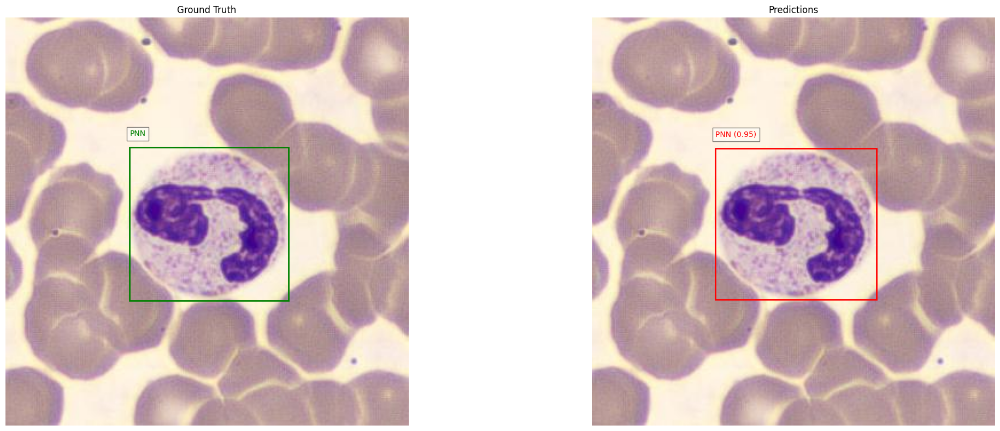


image 1/1 /content/output/test/images/389a7006-5.jpg: 640x640 1 LM, 14.9ms
Speed: 9.7ms preprocess, 14.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
Image: 389a7006-5.jpg, Predictions: [[22, 0.7785513401031494, 0.5015498399734497, 0.501268208026886, 0.2771654725074768, 0.32007160782814026]]


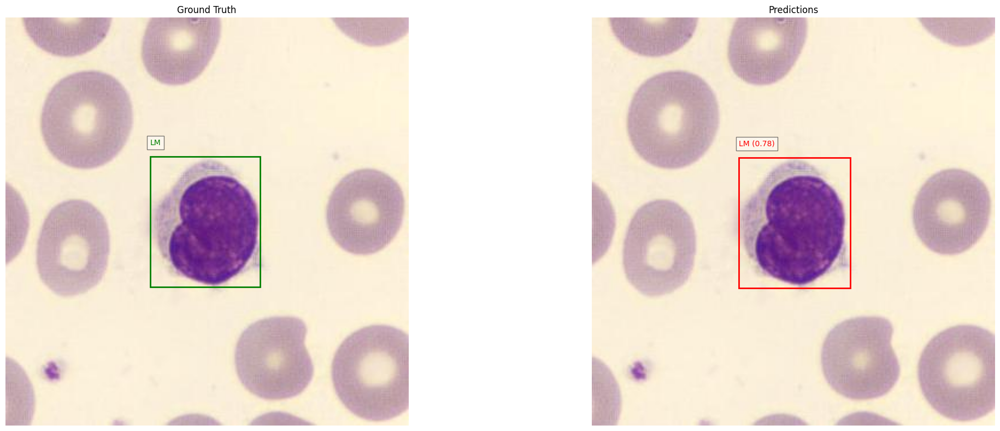


image 1/1 /content/output/test/images/615e4e5b-2.jpg: 640x640 1 B, 18.6ms
Speed: 4.1ms preprocess, 18.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
Image: 615e4e5b-2.jpg, Predictions: [[20, 0.9744551777839661, 0.5047649145126343, 0.5052297115325928, 0.2734936773777008, 0.33239033818244934]]


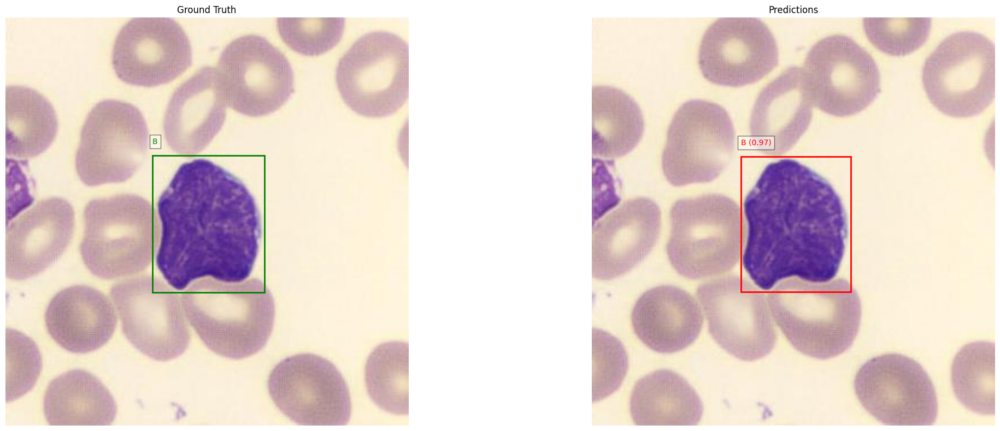


image 1/1 /content/output/test/images/291c584d-e.jpg: 640x640 1 LZMG, 10.6ms
Speed: 4.2ms preprocess, 10.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Image: 291c584d-e.jpg, Predictions: [[14, 0.9709488749504089, 0.5056305527687073, 0.5039350986480713, 0.4136708974838257, 0.3716031610965729]]


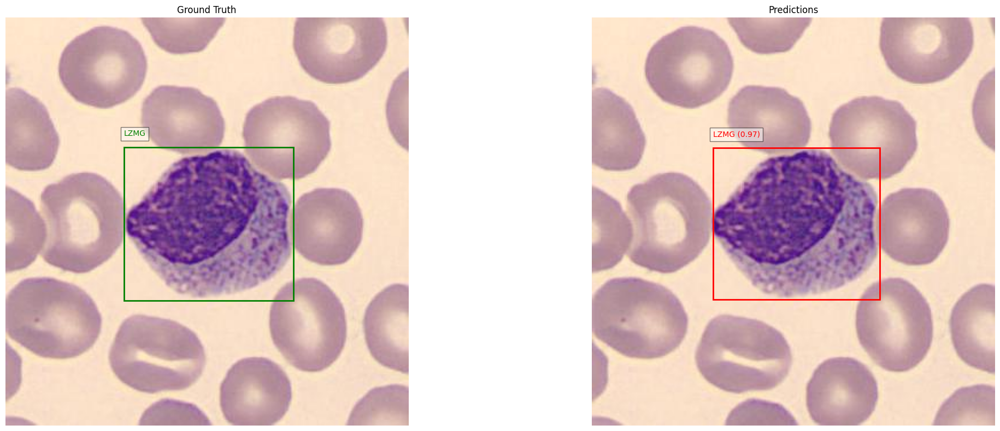


image 1/1 /content/output/test/images/a606f02b-c.jpg: 640x640 1 LLC, 11.5ms
Speed: 4.1ms preprocess, 11.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Image: a606f02b-c.jpg, Predictions: [[17, 0.9864814281463623, 0.4956377446651459, 0.49929937720298767, 0.5108495354652405, 0.5083791613578796]]


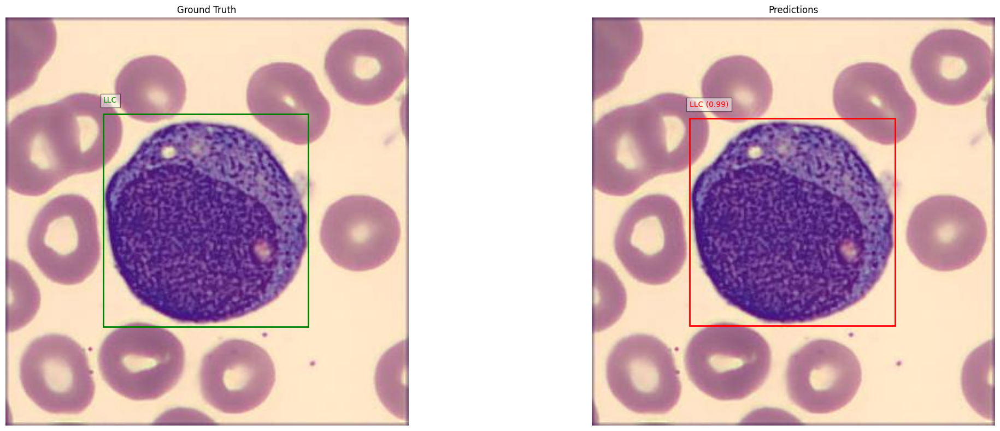


image 1/1 /content/output/test/images/35871b1b-c.jpg: 640x640 1 MBL, 10.0ms
Speed: 4.1ms preprocess, 10.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)
Image: 35871b1b-c.jpg, Predictions: [[15, 0.8332751989364624, 0.6800773739814758, 0.49705830216407776, 0.4203820824623108, 0.40366217494010925]]


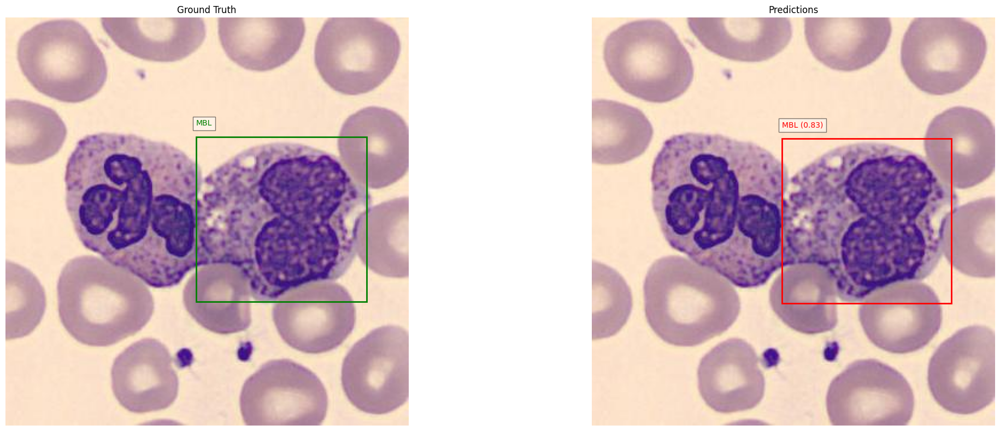

In [75]:
for random_sample in random_samples:
    sample_image_path = os.path.join(test_images_dir, random_sample)

    # Ground truth: Load from corresponding label file
    gt_label_file = sample_image_path.replace('images', 'labels').replace('.jpg', '.txt')
    with open(gt_label_file, 'r') as f:
        ground_truth = [list(map(float, line.strip().split())) for line in f.readlines()]

    # Predictions: Run inference on the sample image
    results = model.predict(source=sample_image_path, conf=0.1)  # Lower confidence threshold to capture more predictions
    if results and hasattr(results[0], 'boxes') and results[0].boxes is not None:
        boxes = results[0].boxes
        class_ids = boxes.cls.cpu().numpy().astype(int).tolist()
        confidences = boxes.conf.cpu().numpy().tolist()
        bboxes = boxes.xywhn.cpu().numpy().tolist()
        predictions = [[class_ids[i], confidences[i]] + bboxes[i] for i in range(len(bboxes))]
        print(f"Image: {random_sample}, Predictions: {predictions}")  # Debug statement
    else:
        predictions = []
        print(f"Image: {random_sample}, No predictions found.")  # Debug statement

    # Visualize the image
    visualize_sample(sample_image_path, ground_truth, predictions, class_names)


In [ ]:
# post_training_files_path = '/content/runs/detect/train3'

# # Construct the path to the best model weights file using os.path.join
# best_model_path = os.path.join(post_training_files_path, 'weights/best.pt')

# # Load the best model weights into the YOLO model
# best_model = YOLO(best_model_path)

# # Validate the best model using the validation set with default parameters
# metrics = best_model.val(split='val')

In [ ]:
# metrics_df = metrics.rename(columns={'some_column': 'Metric Value'})
# metrics_df

# Detect Nested Boxes
